In [120]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

pd.set_option('display.max_columns',None)

In [121]:
#  pip install seaborn==0.11.0

In [193]:
df = pd.read_csv('mmALL_073119_csv.csv')

In [194]:
df[['region','country']]

,region,country
0,North America,Canada
1,North America,Canada
2,North America,Canada
3,North America,Canada
4,North America,Canada
...,...,...
16358,Oceania,Papua New Guinea
16359,Oceania,Papua New Guinea
16360,Oceania,Papua New Guinea
16361,Oceania,Papua New Guinea


In [404]:
euro_df = df[df['region'] == 'Europe'].copy()
asia_df = df[df['region'] == 'Asia'].copy()
africa_df = df[df['region'] == 'Africa'].copy()
sa_df = df[df['region'] == 'South America'].copy()
mena_df = df[df['region'] == 'MENA'].copy()
na_df = df[df['region'] == 'North America'].copy()
ca_df = df[df['region'] == 'Central America'].copy()
oc_df = df[df['region'] == 'Oceania'].copy()

In [405]:
africa_df['country'].unique()

array(['Cape Verde', 'Guinea-Bissau', 'Equatorial Guinea', 'Gambia',
       'Mali', 'Senegal', 'Benin', 'Mauritania', 'Niger', 'Ivory Coast',
       'Guinea', 'Burkina Faso', 'Liberia', 'Sierra Leone', 'Ghana',
       'Togo', 'Cameroon', 'Nigeria', 'Gabon', 'Central African Republic',
       'Chad', 'Congo Brazzaville', 'Congo Kinshasa', 'Uganda', 'Kenya',
       'Tanzania', 'Burundi', 'Rwanda', 'Somalia', 'Djibouti',
       'South Sudan', 'Ethiopia', 'Eritrea', 'Angola', 'Mozambique',
       'Zambia', 'Zimbabwe', 'Malawi', 'South Africa', 'Namibia',
       'Lesotho', 'Botswana', 'Swaziland', 'Madagascar', 'Comoros',
       'Mauritius'], dtype=object)

In [407]:
africa_df.sum()

id                                                        18224602083904
country                Cape VerdeCape VerdeCape VerdeCape VerdeCape V...
ccode                                                            1821732
year                                                             7282057
region                 AfricaAfricaAfricaAfricaAfricaAfricaAfricaAfri...
protest                                                             3043
protestnumber                                                      26904
startday                                                           48099
startmonth                                                         18689
startyear                                                    6.10545e+06
endday                                                             48355
endmonth                                                           18708
endyear                                                      6.10545e+06
protesterviolence                                  

# Basic Review of the Dataframe

In [126]:
df.head(2)

,id,country,ccode,year,region,protest,protestnumber,startday,startmonth,startyear,endday,endmonth,endyear,protesterviolence,location,participants_category,participants,protesteridentity,protesterdemand1,protesterdemand2,protesterdemand3,protesterdemand4,stateresponse1,stateresponse2,stateresponse3,stateresponse4,stateresponse5,stateresponse6,stateresponse7,sources,notes
0,201990001,Canada,20,1990,North America,1,1,15.0,1.0,1990.0,15.0,1.0,1990.0,0.0,national,NaN,1000s,unspecified,"political behavior, process",labor wage dispute,NaN,NaN,ignore,NaN,NaN,NaN,NaN,NaN,NaN,1. Great Canadian train journeys into history;...,Canada s railway passenger system was finally...
1,201990002,Canada,20,1990,North America,1,2,25.0,6.0,1990.0,25.0,6.0,1990.0,0.0,"Montreal, Quebec",NaN,1000,unspecified,"political behavior, process",NaN,NaN,NaN,ignore,NaN,NaN,NaN,NaN,NaN,NaN,1. Autonomy s Cry Revived in Quebec The New Yo...,protestors were only identified as young peop...


In [127]:
df.shape

(16363, 31)

In [128]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 16363 entries, 0 to 16362
Data columns (total 31 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   id                     16363 non-null  int64  
 1   country                16363 non-null  object 
 2   ccode                  16363 non-null  int64  
 3   year                   16363 non-null  int64  
 4   region                 16363 non-null  object 
 5   protest                16363 non-null  int64  
 6   protestnumber          16363 non-null  int64  
 7   startday               14514 non-null  float64
 8   startmonth             14514 non-null  float64
 9   startyear              14514 non-null  float64
 10  endday                 14514 non-null  float64
 11  endmonth               14514 non-null  float64
 12  endyear                14514 non-null  float64
 13  protesterviolence      15033 non-null  float64
 14  location               14493 non-null  object 
 15  pa

In [129]:
df.columns

Index(['id', 'country', 'ccode', 'year', 'region', 'protest', 'protestnumber',
       'startday', 'startmonth', 'startyear', 'endday', 'endmonth', 'endyear',
       'protesterviolence', 'location', 'participants_category',
       'participants', 'protesteridentity', 'protesterdemand1',
       'protesterdemand2', 'protesterdemand3', 'protesterdemand4',
       'stateresponse1', 'stateresponse2', 'stateresponse3', 'stateresponse4',
       'stateresponse5', 'stateresponse6', 'stateresponse7', 'sources',
       'notes'],
      dtype='object')

In [130]:
categorical_columns = ['country', 'ccode', 'year', 'region', 'protest', 'protestnumber',
       'protesterviolence',  'participants_category',
       'participants', 'protesterdemand1',
       'protesterdemand2', 'protesterdemand3', 'protesterdemand4',
       'stateresponse1', 'stateresponse2', 'stateresponse3', 'stateresponse4',
       'stateresponse5', 'stateresponse6', 'stateresponse7']

numerical_columns = ['startday', 'startmonth', 'startyear', 'endday', 'endmonth', 'endyear',]

id_columns = ['id','sources','notes', 'protesteridentity', 'location']

In [131]:
for category in categorical_columns:
    print(f'Category is: {category}\n.')
    print(df[category].value_counts())
    print('\n\n\n')

Category is: country
.
United Kingdom           547
France                   527
Ireland                  434
Germany                  360
Kenya                    350
                        ... 
Germany East              11
South Sudan                9
Czechoslovakia             6
Serbia and Montenegro      5
Germany West               2
Name: country, Length: 166, dtype: int64




Category is: ccode
.
200    547
220    527
205    434
255    360
501    350
      ... 
529     11
525      9
315      6
678      4
260      2
Name: ccode, Length: 168, dtype: int64




Category is: year
.
2015    920
2014    830
2016    766
2018    746
2011    739
2013    636
1990    630
2012    604
2017    600
2005    551
1997    546
2000    537
2006    525
1998    511
2010    510
2007    504
2004    499
1999    481
2002    477
1992    475
1996    472
2008    460
1994    457
2001    455
2003    453
2009    439
1991    436
1995    425
1993    390
2019    289
Name: year, dtype: int64




Category is: region

In [13]:

def bar_plot(df, columns):
    for category in columns:

        y_names = df[category].value_counts().index
        width = df[category].value_counts()

        plt.figure(figsize=(6,(len(y_names)/4)))
        plt.barh(y_names,width)
        plt.title('Category is: ' + category)
        plt.ylabel('category names')
        plt.xlabel('Number of values in a category')
        plt.show()

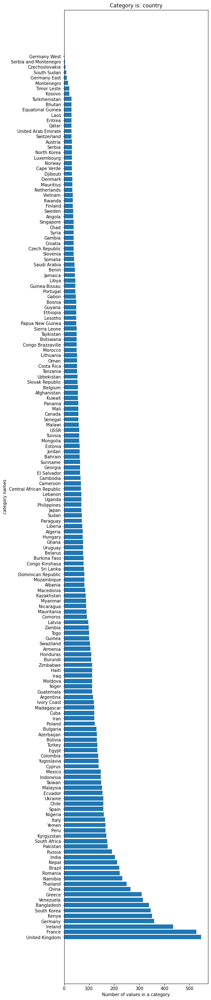

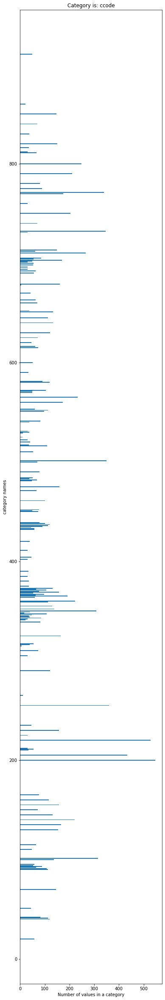

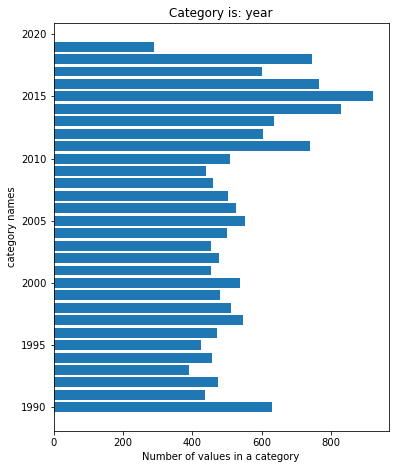

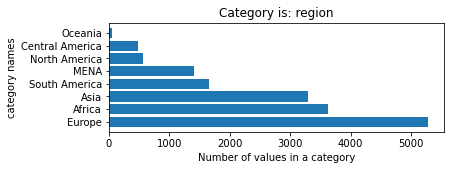

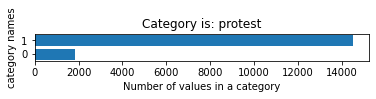

...

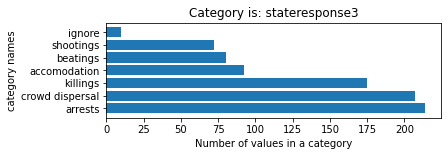

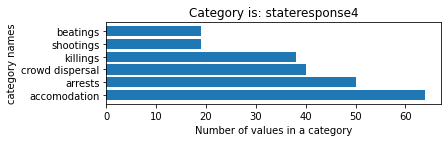

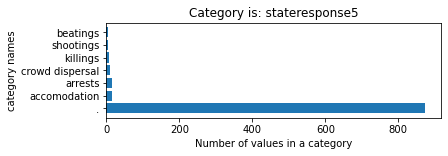

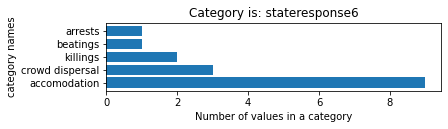

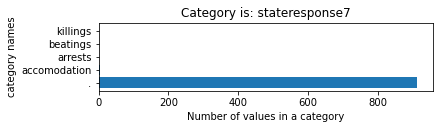

In [14]:
bar_plot(df, categorical_columns)

In [15]:
#Questions - is there a general pattern where a protest starts in one way, has a reaction by the state, and then morphs

# does this occur similarly in a given region?

# do certain regions generally have certain protests?

# is there a pattern to the protest demands (certain demographics in a country - more dictator, ...)


# Update Days (per Aaron)

In [195]:
# some engineering for protest length by total days

df['years'] = df['endyear'] - df['startyear']
df['months'] = df['endmonth'] - df['startmonth']
df['days'] = df['endday'] - df['startday']
df['total_days'] = df['days'] + (df['months']*30.5) + (df['years']*365)

# Review category columns

In [196]:
df.head(2)

,id,country,ccode,year,region,protest,protestnumber,startday,startmonth,startyear,endday,endmonth,endyear,protesterviolence,location,participants_category,participants,protesteridentity,protesterdemand1,protesterdemand2,protesterdemand3,protesterdemand4,stateresponse1,stateresponse2,stateresponse3,stateresponse4,stateresponse5,stateresponse6,stateresponse7,sources,notes,years,months,days,total_days
0,201990001,Canada,20,1990,North America,1,1,15.0,1.0,1990.0,15.0,1.0,1990.0,0.0,national,NaN,1000s,unspecified,"political behavior, process",labor wage dispute,NaN,NaN,ignore,NaN,NaN,NaN,NaN,NaN,NaN,1. Great Canadian train journeys into history;...,Canada s railway passenger system was finally...,0.0,0.0,0.0,0.0
1,201990002,Canada,20,1990,North America,1,2,25.0,6.0,1990.0,25.0,6.0,1990.0,0.0,"Montreal, Quebec",NaN,1000,unspecified,"political behavior, process",NaN,NaN,NaN,ignore,NaN,NaN,NaN,NaN,NaN,NaN,1. Autonomy s Cry Revived in Quebec The New Yo...,protestors were only identified as young peop...,0.0,0.0,0.0,0.0


## create dummy columns with recognizable column names

In [197]:
protest_demands = ['protesterdemand1','protesterdemand2', 'protesterdemand3', 'protesterdemand4']

state_responses = ['stateresponse1', 'stateresponse2', 'stateresponse3', 'stateresponse4','stateresponse5', 'stateresponse6', 'stateresponse7']




In [ ]:
# create dummy columns with recognizable column names

def get_dum_cols(df, list_of_columns):
    list_of_dfs = []

    for col in list_of_columns:
        col_df = pd.get_dummies(df[col])
        list_of_dfs.append(col_df)

    #combine all df's vertically, so only areas with null values are where a potential column was empty    
    dfs_concat = pd.concat(list_of_dfs, axis = 0).fillna(0)
    
    #convert the concatenated df with all values now filled in into a list of separate dfs - each with all columns
    num_dfs = len(list_of_columns)
    num_rows = len(df)

    list_of_final_dfs = []
    
    for i in range(num_dfs):
        new_df = dfs_concat[num_rows*i : num_rows*(i+1)]
        list_of_final_dfs.append(new_df)
   
    # create combined final df
    
    final_df = list_of_final_dfs[0]
    
    for j in range(1, len(list_of_final_dfs)):
        final_df += list_of_final_dfs[j]
    
    return final_df

In [410]:
df[protest_demands]

,protesterdemand1,protesterdemand2,protesterdemand3,protesterdemand4
0,1.0,10.0,0.0,0.0
1,1.0,0.0,0.0,0.0
2,1.0,0.0,0.0,0.0
3,100000.0,0.0,0.0,0.0
4,1.0,0.0,0.0,0.0
...,...,...,...,...
16358,1.0,100000.0,0.0,0.0
16359,1.0,0.0,0.0,0.0
16360,1.0,0.0,0.0,0.0
16361,0.0,0.0,0.0,0.0


In [204]:
#creates a combined dummy dataframe for each
df_protest_demands_group = get_dum_cols(df, protest_demands)

df_state_response_group = get_dum_cols(df, state_responses)

In [205]:
df_protest_demands_group.sum()

labor wage dispute              2146.0
land farm issue                  563.0
police brutality                1001.0
political behavior, process    10192.0
price increases, tax policy     1373.0
removal of politician           1614.0
social restrictions              628.0
.                                874.0
dtype: float64

In [207]:
df_protest_demands_group.head()

,labor wage dispute,land farm issue,police brutality,"political behavior, process","price increases, tax policy",removal of politician,social restrictions,.
0,1,0,0,1,0,0,0.0,0.0
1,0,0,0,1,0,0,0.0,0.0
2,0,0,0,1,0,0,0.0,0.0
3,0,1,0,0,0,0,0.0,0.0
4,0,0,0,1,0,0,0.0,0.0


In [208]:
df_state_response_group.sum()

accomodation       1503.0
arrests            2022.0
beatings            774.0
crowd dispersal    4439.0
ignore             7977.0
killings            770.0
shootings           869.0
.                  1787.0
dtype: float64

In [209]:
df_state_response_group.head()

,accomodation,arrests,beatings,crowd dispersal,ignore,killings,shootings,.
0,0,0,0,0.0,1.0,0,0.0,0.0
1,0,0,0,0.0,1.0,0,0.0,0.0
2,0,0,0,0.0,1.0,0,0.0,0.0
3,1,0,0,0.0,0.0,0,0.0,0.0
4,1,1,0,1.0,0.0,0,0.0,0.0


In [340]:
list_of_responses = list(df_state_response_group.drop(columns='.').columns)
list_of_responses

['accomodation',
 'arrests',
 'beatings',
 'crowd dispersal',
 'ignore',
 'killings',
 'shootings']

In [341]:
list_of_demands = list(df_protest_demands_group.drop(columns='.').columns)
list_of_demands

['labor wage dispute',
 'land farm issue',
 'police brutality',
 'political behavior, process',
 'price increases, tax policy',
 'removal of politician',
 'social restrictions']

## add a state_violence column

In [344]:
violent_responses = ['beatings','killings','shootings']

for response in violent_responses:
    df['state_violence'] = df_state_response_group[response]

df['state_violence'].apply(lambda x: 1 if x > 0 else 0)


0        0
1        0
2        0
3        0
4        0
        ..
16358    0
16359    0
16360    0
16361    0
16362    0
Name: state_violence, Length: 16363, dtype: int64

In [345]:
df['state_violence'].sum()

869.0

## change values in category columns, so can add together

In [210]:
# turning columns into demands


protesterdemand_codes = {'political behavior, process':1,
                         'labor wage dispute':10,
                         'price increases, tax policy':100,
                         'removal of politician':1_000,
                         'police brutality':10_000,
                         'land farm issue':100_000,
                         'social restrictions':1_000_000}


stateresponse_codes = {'accomodation':1,
                       'ignore':10,
                       'arrests':100,
                       'crowd dispersal':1_000,
                       'shootings':10_000,
                       'beatings':100_000,
                       'killings':1_000_000}

# turn columns into numbers
# mapping follows Aaron's notes

for col in protest_demands:
    df[col] = df[col].map(protesterdemand_codes)
    
for col in state_responses:
    df[col] = df[col].map(stateresponse_codes)   
    
df[protest_demands] = df[protest_demands].fillna(0)
df[state_responses] = df[state_responses].fillna(0)    

df['protesterdemand'] = df['protesterdemand1'] + df['protesterdemand2'] + df['protesterdemand3'] + df['protesterdemand4']

df['stateresponse'] = df['stateresponse1'] + df['stateresponse2'] + df['stateresponse3'] + df['stateresponse4'] + df['stateresponse5'] + df['stateresponse6'] + df['stateresponse7'] 

In [211]:
df[protest_demands].head()

,protesterdemand1,protesterdemand2,protesterdemand3,protesterdemand4
0,1.0,10.0,0.0,0.0
1,1.0,0.0,0.0,0.0
2,1.0,0.0,0.0,0.0
3,100000.0,0.0,0.0,0.0
4,1.0,0.0,0.0,0.0


In [212]:
df[state_responses].head()

,stateresponse1,stateresponse2,stateresponse3,stateresponse4,stateresponse5,stateresponse6,stateresponse7
0,10.0,0.0,0.0,0.0,0.0,0.0,0.0
1,10.0,0.0,0.0,0.0,0.0,0.0,0.0
2,10.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1000.0,100.0,1.0,0.0,0.0,0.0,0.0


In [213]:
# Figure out how many different combinations of protester demands there were
df['protesterdemand'].value_counts().sort_index()

0.0          1860
1.0          7744
10.0         1349
11.0          478
100.0         772
             ... 
1011000.0       1
1011001.0       1
1100000.0       7
1100001.0       1
1100011.0       1
Name: protesterdemand, Length: 64, dtype: int64

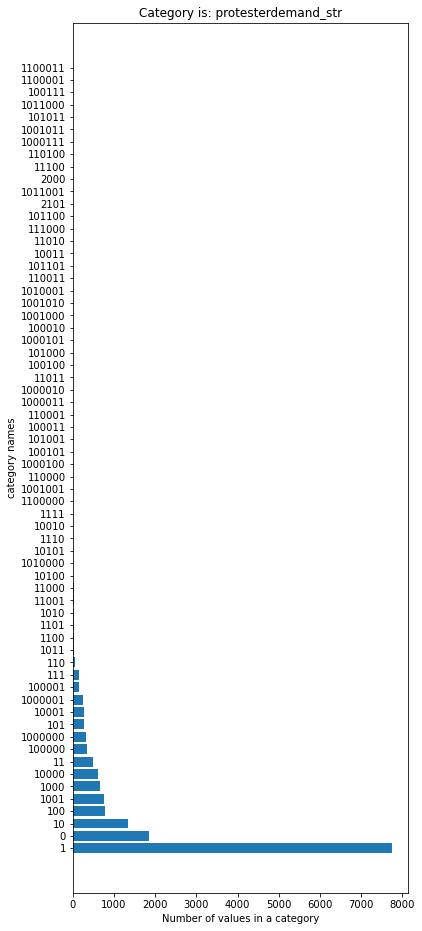

In [329]:
df['protesterdemand_int'] = df['protesterdemand'].apply(lambda x: int(x))
df['protesterdemand_str'] = df['protesterdemand_int'].apply(lambda x: str(x))

bar_plot(df, ['protesterdemand_str'])

In [215]:
# Figure out how many different combinations of state response there were

df['stateresponse'].value_counts().sort_index()

0.0          1878
1.0           867
10.0         7688
11.0          145
100.0         602
             ... 
1111100.0      12
1111101.0       5
1112001.0       1
2000000.0       1
2100100.0       1
Name: stateresponse, Length: 115, dtype: int64

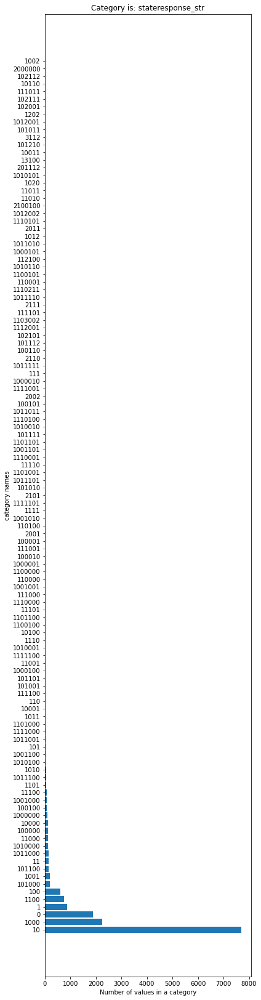

In [330]:
df['stateresponse_int'] = df['stateresponse'].apply(lambda x: int(x))
df['stateresponse_str'] = df['stateresponse_int'].apply(lambda x: str(x))

bar_plot(df, ['stateresponse_str'])

In [217]:
# most categories only appear once (likely an error where they appear twice)

# Create a cleaned up data frame

In [411]:
# create a final data frame of relevant columns

df.columns

Index(['id', 'country', 'ccode', 'year', 'region', 'protest', 'protestnumber',
       'startday', 'startmonth', 'startyear', 'endday', 'endmonth', 'endyear',
       'protesterviolence', 'location', 'participants_category',
       'participants', 'protesteridentity', 'protesterdemand1',
       'protesterdemand2', 'protesterdemand3', 'protesterdemand4',
       'stateresponse1', 'stateresponse2', 'stateresponse3', 'stateresponse4',
       'stateresponse5', 'stateresponse6', 'stateresponse7', 'sources',
       'notes', 'years', 'months', 'days', 'total_days', 'protesterdemand',
       'stateresponse', 'protesterdemand_int', 'protesterdemand_str',
       'stateresponse_int', 'stateresponse_str', 'state_violence'],
      dtype='object')

In [412]:
df_protest_demands_group.columns

Index(['labor wage dispute', 'land farm issue', 'police brutality',
       'political behavior, process', 'price increases, tax policy',
       'removal of politician', 'social restrictions', '.'],
      dtype='object')

In [413]:
df_state_response_group.columns

Index(['accomodation', 'arrests', 'beatings', 'crowd dispersal', 'ignore',
       'killings', 'shootings', '.'],
      dtype='object')

In [349]:
df_short = df[['id', 'country', 'ccode', 'year', 'region', 'protest', 'protestnumber',
       'startday', 'startmonth', 'startyear', 'endday', 'endmonth', 'endyear',
       'protesterviolence', 'location', 'participants_category',
       'participants', 'protesteridentity', 'sources',
       'notes', 'total_days', 'protesterdemand',
       'stateresponse','state_violence']].copy()

In [350]:
df_all = pd.concat([df, df_protest_demands_group, df_state_response_group], axis = 1)
df_all.set_index('id', inplace=True)
df_all.to_csv('df_all.csv', index = False)

In [409]:
df_all.sum()

country                        CanadaCanadaCanadaCanadaCanadaCanadaCanadaCana...
ccode                                                                    7141024
year                                                                    32816718
region                         North AmericaNorth AmericaNorth AmericaNorth A...
protest                                                                    14514
protestnumber                                                             117317
startday                                                                  224246
startmonth                                                                 89442
startyear                                                            2.91105e+07
endday                                                                    226066
endmonth                                                                   89696
endyear                                                              2.91105e+07
protesterviolence           

In [351]:
# combines relevant columns from original dataframe (df_short), 
# with the dummified columns of protest demands (df_protest_demands_group),
# and the dummified columns of state response from above (df_state_response_group)

df_with_categories = pd.concat([df_short, df_protest_demands_group, df_state_response_group], axis = 1)

In [352]:
# set the index to the id since the id won't be used otherwise anyway

df_with_categories.set_index('id', inplace=True)

In [353]:
df_with_categories.to_csv('df_categories.csv',index = False)

In [354]:
# explore cleaned up dataframe

df_with_categories.head()

,country,ccode,year,region,protest,protestnumber,startday,startmonth,startyear,endday,endmonth,endyear,protesterviolence,location,participants_category,participants,protesteridentity,sources,notes,total_days,protesterdemand,stateresponse,state_violence,labor wage dispute,land farm issue,police brutality,"political behavior, process","price increases, tax policy",removal of politician,social restrictions,.,accomodation,arrests,beatings,crowd dispersal,ignore,killings,shootings,.
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
201990001,Canada,20,1990,North America,1,1,15.0,1.0,1990.0,15.0,1.0,1990.0,0.0,national,NaN,1000s,unspecified,1. Great Canadian train journeys into history;...,Canada s railway passenger system was finally...,0.0,11.0,10.0,0.0,1,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990002,Canada,20,1990,North America,1,2,25.0,6.0,1990.0,25.0,6.0,1990.0,0.0,"Montreal, Quebec",NaN,1000,unspecified,1. Autonomy s Cry Revived in Quebec The New Yo...,protestors were only identified as young peop...,0.0,1.0,10.0,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990003,Canada,20,1990,North America,1,3,1.0,7.0,1990.0,1.0,7.0,1990.0,0.0,"Montreal, Quebec",NaN,500,separatist Parti Quebecois,1. Quebec protest after Queen calls for unity ...,"THE Queen, after calling on Canadians to rema...",0.0,1.0,10.0,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990004,Canada,20,1990,North America,1,4,12.0,7.0,1990.0,6.0,9.0,1990.0,1.0,"Montreal, Quebec",NaN,100s,Mohawk Indians,1. Indians Gather as Siege Intensifies; Armed ...,Canada s federal government has agreed to acq...,55.0,100000.0,1.0,0.0,0,1,0,0,0,0,0.0,0.0,1,0,0,0.0,0.0,0,0.0,0.0
201990005,Canada,20,1990,North America,1,5,14.0,8.0,1990.0,15.0,8.0,1990.0,1.0,"Montreal, Quebec",NaN,950,local residents,1. Dozens hurt in Mohawk blockade protest The ...,Protests were directed against the state due t...,1.0,1.0,1101.0,0.0,0,0,0,1,0,0,0.0,0.0,1,1,0,1.0,0.0,0,0.0,0.0


In [355]:
df_with_categories.columns

Index(['country', 'ccode', 'year', 'region', 'protest', 'protestnumber',
       'startday', 'startmonth', 'startyear', 'endday', 'endmonth', 'endyear',
       'protesterviolence', 'location', 'participants_category',
       'participants', 'protesteridentity', 'sources', 'notes', 'total_days',
       'protesterdemand', 'stateresponse', 'state_violence',
       'labor wage dispute', 'land farm issue', 'police brutality',
       'political behavior, process', 'price increases, tax policy',
       'removal of politician', 'social restrictions', '.', 'accomodation',
       'arrests', 'beatings', 'crowd dispersal', 'ignore', 'killings',
       'shootings', '.'],
      dtype='object')

In [356]:
df_with_categories.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 16363 entries, 201990001 to 9102019000
Data columns (total 39 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   country                      16363 non-null  object 
 1   ccode                        16363 non-null  int64  
 2   year                         16363 non-null  int64  
 3   region                       16363 non-null  object 
 4   protest                      16363 non-null  int64  
 5   protestnumber                16363 non-null  int64  
 6   startday                     14514 non-null  float64
 7   startmonth                   14514 non-null  float64
 8   startyear                    14514 non-null  float64
 9   endday                       14514 non-null  float64
 10  endmonth                     14514 non-null  float64
 11  endyear                      14514 non-null  float64
 12  protesterviolence            15033 non-null  float64
 13  loc

In [357]:
df_with_categories.describe()

,ccode,year,protest,protestnumber,startday,startmonth,startyear,endday,endmonth,endyear,protesterviolence,total_days,protesterdemand,stateresponse,state_violence,labor wage dispute,land farm issue,police brutality,"political behavior, process","price increases, tax policy",removal of politician,social restrictions,.,accomodation,arrests,beatings,crowd dispersal,ignore,killings,shootings,.
count,16363.000000,16363.000000,16363.000000,16363.000000,14514.000000,14514.000000,14514.000000,14514.000000,14514.000000,14514.000000,15033.000000,14514.000000,1.636300e+04,1.636300e+04,16363.000000,16363.000000,16363.000000,16363.000000,16363.000000,16363.000000,16363.000000,16363.000000,16363.000000,16363.000000,16363.000000,16363.000000,16363.000000,16363.000000,16363.000000,16363.000000,16363.000000
mean,436.412883,2005.544093,0.887001,7.169651,15.450324,6.162464,2005.684649,15.575720,6.179964,2005.687405,0.253842,1.665082,4.254067e+04,5.260725e+04,0.053108,0.131150,0.034407,0.061175,0.622869,0.083909,0.098637,0.038379,0.053413,0.091854,0.123571,0.047302,0.271283,0.487502,0.047057,0.053108,0.109210
std,232.426438,8.718902,0.316601,11.635211,8.830148,3.454530,8.696184,8.815945,3.454780,8.697528,0.435222,16.143717,1.925058e+05,2.167798e+05,0.224255,0.337574,0.182278,0.239658,0.484683,0.277259,0.298593,0.192116,0.224863,0.291146,0.329659,0.212578,0.448876,0.499981,0.212345,0.224255,0.311912
min,20.000000,1990.000000,0.000000,0.000000,1.000000,1.000000,1990.000000,1.000000,1.000000,1990.000000,0.000000,-0.500000,0.000000e+00,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,220.000000,1998.000000,1.000000,1.000000,8.000000,3.000000,1998.000000,8.000000,3.000000,1998.000000,0.000000,0.000000,1.000000e+00,1.000000e+01,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,433.000000,2006.000000,1.000000,3.000000,15.000000,6.000000,2007.000000,16.000000,6.000000,2007.000000,0.000000,0.000000,1.000000e+00,1.000000e+01,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,645.000000,2014.000000,1.000000,8.000000,23.000000,9.000000,2014.000000,23.000000,9.000000,2014.000000,1.000000,0.000000,1.010000e+02,1.000000e+03,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,0.000000
max,910.000000,2019.000000,1.000000,143.000000,31.000000,12.000000,2019.000000,31.000000,12.000000,2019.000000,1.000000,935.000000,1.100011e+06,2.100100e+06,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,2.000000,1.000000,1.000000,2.000000,2.000000,2.000000,3.000000,2.000000,2.000000,1.000000,1.000000


In [358]:
# dataframe of when accommodations met

acc = df_with_categories[df_with_categories['accomodation'] == 1].drop(columns = ['protesterdemand', 'stateresponse','year','startyear','endyear']).copy()
acc.head()

,country,ccode,region,protest,protestnumber,startday,startmonth,endday,endmonth,protesterviolence,location,participants_category,participants,protesteridentity,sources,notes,total_days,state_violence,labor wage dispute,land farm issue,police brutality,"political behavior, process","price increases, tax policy",removal of politician,social restrictions,.,accomodation,arrests,beatings,crowd dispersal,ignore,killings,shootings,.
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
201990004,Canada,20,North America,1,4,12.0,7.0,6.0,9.0,1.0,"Montreal, Quebec",NaN,100s,Mohawk Indians,1. Indians Gather as Siege Intensifies; Armed ...,Canada s federal government has agreed to acq...,55.0,0.0,0,1,0,0,0,0,0.0,0.0,1,0,0,0.0,0.0,0,0.0,0.0
201990005,Canada,20,North America,1,5,14.0,8.0,15.0,8.0,1.0,"Montreal, Quebec",NaN,950,local residents,1. Dozens hurt in Mohawk blockade protest The ...,Protests were directed against the state due t...,1.0,0.0,0,0,0,1,0,0,0.0,0.0,1,1,0,1.0,0.0,0,0.0,0.0
202000002,Canada,20,North America,1,2,26.0,2.0,26.0,2.0,0.0,"Saskatoon, Saskatchewan",NaN,400,unspecified,"1. The Washington Post, Indian Deaths Compound...",This protest followed multiple deaths of young...,0.0,0.0,0,0,1,0,0,0,0.0,0.0,1,0,0,0.0,0.0,0,0.0,0.0
202016006,Canada,20,North America,1,6,12.0,4.0,12.0,4.0,0.0,"Queen s Park, Toronto",100-999,more than 200,Ontario Autism Coalition,"1. Shame on you all! The Toronto Star, Ap...",More than 200 parents arrived at Queen s Park...,0.0,0.0,0,0,0,1,0,0,0.0,0.0,1,0,0,0.0,0.0,0,0.0,0.0
202018001,Canada,20,North America,1,1,9.0,2.0,9.0,2.0,0.0,Saskatchewan,100-999,widespread,Indigenous,Trudeau to Meet With Family of Fatally Shot C...,After widespread protests over the acquittal ...,0.0,0.0,0,0,0,1,0,0,0.0,0.0,1,0,0,0.0,0.0,0,0.0,0.0


In [359]:
# when accommodations not met

no_acc = df_with_categories[df_with_categories['accomodation'] == 0].drop(columns = ['protesterdemand', 'stateresponse','year','startyear','endyear']).copy()
no_acc.head()

,country,ccode,region,protest,protestnumber,startday,startmonth,endday,endmonth,protesterviolence,location,participants_category,participants,protesteridentity,sources,notes,total_days,state_violence,labor wage dispute,land farm issue,police brutality,"political behavior, process","price increases, tax policy",removal of politician,social restrictions,.,accomodation,arrests,beatings,crowd dispersal,ignore,killings,shootings,.
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
201990001,Canada,20,North America,1,1,15.0,1.0,15.0,1.0,0.0,national,NaN,1000s,unspecified,1. Great Canadian train journeys into history;...,Canada s railway passenger system was finally...,0.0,0.0,1,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990002,Canada,20,North America,1,2,25.0,6.0,25.0,6.0,0.0,"Montreal, Quebec",NaN,1000,unspecified,1. Autonomy s Cry Revived in Quebec The New Yo...,protestors were only identified as young peop...,0.0,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990003,Canada,20,North America,1,3,1.0,7.0,1.0,7.0,0.0,"Montreal, Quebec",NaN,500,separatist Parti Quebecois,1. Quebec protest after Queen calls for unity ...,"THE Queen, after calling on Canadians to rema...",0.0,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990006,Canada,20,North America,1,6,19.0,9.0,19.0,9.0,0.0,"Kahnawake Reservation near Montreal, Quebec",NaN,200,Mohawk Indians,1. Mohawks Tear Gassed in Clash The Washington...,Canadian army troops today fired tear gas int...,0.0,1.0,0,0,1,0,0,0,0.0,0.0,0,0,0,1.0,0.0,0,1.0,0.0
201991001,Canada,20,North America,1,1,10.0,9.0,17.0,9.0,0.0,national,NaN,110000,Public Service Alliance of Canada,1. Mulroney Acts to Crush Strike by Federal Wo...,"Brian Mulroney, the embattled Conservative Pr...",7.0,0.0,1,0,0,0,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0


In [360]:
#https://seaborn.pydata.org/generated/seaborn.boxplot.html
    

plt.figure(figsize = (6,12))
sns.boxplot(data=no_acc.drop(columns = ['ccode','total_days']), orient = 'h')
plt.title('Distribution of variables when accommodations are met');

ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

<Figure size 432x864 with 0 Axes>

In [231]:
plt.figure(figsize = (6,12))
sns.boxplot(data=acc.drop(columns = ['ccode','total_days']), orient = 'h')
plt.title('Distribution of variables when accommodations are not met');

ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

<Figure size 432x864 with 0 Axes>

In [361]:
df_acc_test.head()

,country,protest,protestnumber,startday,startmonth,endday,endmonth,protesterviolence,participants_category,participants,total_days,labor wage dispute,land farm issue,police brutality,"political behavior, process","price increases, tax policy",removal of politician,social restrictions,.,accomodation,arrests,beatings,crowd dispersal,ignore,killings,shootings,.
id,,,,,,,,,,,,,,,,,,,,,,,,,,,
201990001,Canada,1,1,15.0,1.0,15.0,1.0,0.0,NaN,1000s,0.0,1,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990002,Canada,1,2,25.0,6.0,25.0,6.0,0.0,NaN,1000,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990003,Canada,1,3,1.0,7.0,1.0,7.0,0.0,NaN,500,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990004,Canada,1,4,12.0,7.0,6.0,9.0,1.0,NaN,100s,55.0,0,1,0,0,0,0,0.0,0.0,1,0,0,0.0,0.0,0,0.0,0.0
201990005,Canada,1,5,14.0,8.0,15.0,8.0,1.0,NaN,950,1.0,0,0,0,1,0,0,0.0,0.0,1,1,0,1.0,0.0,0,0.0,0.0


In [362]:
df_acc_test = df_with_categories.drop(columns = ['protesterdemand', 'stateresponse','year','startyear','ccode','region','location','endyear','protesteridentity','sources','notes']).copy()

plt.figure(figsize = (12,12))
sns.boxplot(data=df_acc_test, orient = 'h')
plt.title('Distribution of variables overall');

ValueError: The truth value of a Series is ambiguous. Use a.empty, a.bool(), a.item(), a.any() or a.all().

<Figure size 864x864 with 0 Axes>

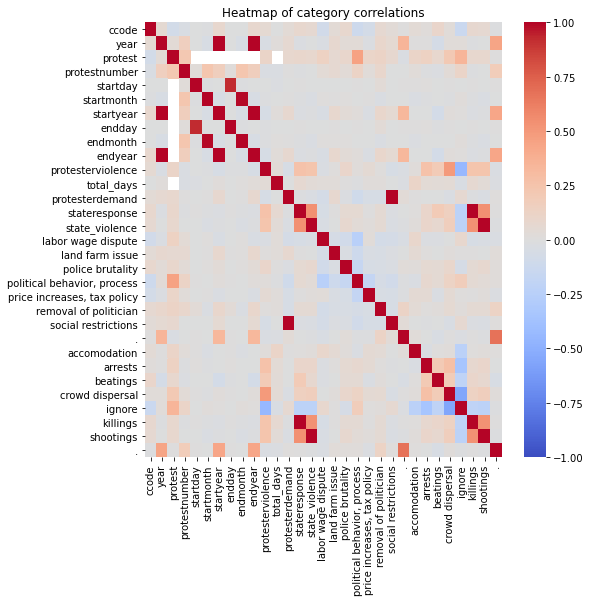

In [366]:
plt.figure(figsize = (8,8))
sns.heatmap(df_with_categories.corr(),
            cmap = 'coolwarm',
            vmin = -1,
            vmax = 1)
plt.title('Heatmap of category correlations');

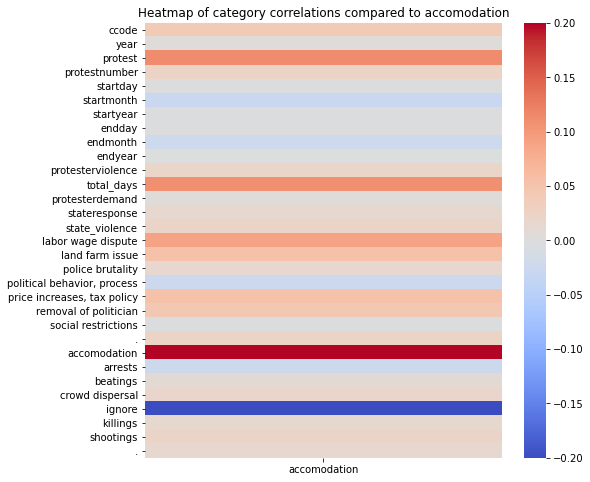

In [367]:
plt.figure(figsize = (8,8))
sns.heatmap(df_with_categories.corr()[['accomodation']],
            cmap = 'coolwarm',
            vmin = -.2,
            vmax = .2)
plt.title('Heatmap of category correlations compared to accomodation');

In [368]:
df_with_categories.corr()[['accomodation']]

,accomodation
ccode,0.039822
year,0.003521
protest,0.112609
protestnumber,0.024934
startday,0.000334
startmonth,-0.028778
startyear,-0.001677
endday,0.001417
endmonth,-0.022692
endyear,-0.001320


In [369]:
df_with_categories.corr()[['state_violence']]

,state_violence
ccode,0.062857
year,-0.004495
protest,0.084528
protestnumber,-0.002399
startday,-0.003990
startmonth,-0.026581
startyear,-0.008882
endday,-0.003469
endmonth,-0.024495
endyear,-0.008760


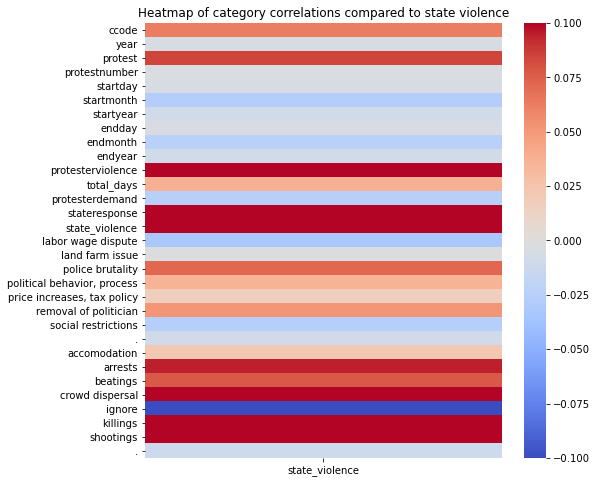

In [371]:
plt.figure(figsize = (8,8))
sns.heatmap(df_with_categories.corr()[['state_violence']],
            cmap = 'coolwarm',
            vmin = -.1,
            vmax = .1)
plt.title('Heatmap of category correlations compared to state violence');

In [372]:
df_with_categories.head()

,country,ccode,year,region,protest,protestnumber,startday,startmonth,startyear,endday,endmonth,endyear,protesterviolence,location,participants_category,participants,protesteridentity,sources,notes,total_days,protesterdemand,stateresponse,state_violence,labor wage dispute,land farm issue,police brutality,"political behavior, process","price increases, tax policy",removal of politician,social restrictions,.,accomodation,arrests,beatings,crowd dispersal,ignore,killings,shootings,.
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
201990001,Canada,20,1990,North America,1,1,15.0,1.0,1990.0,15.0,1.0,1990.0,0.0,national,NaN,1000s,unspecified,1. Great Canadian train journeys into history;...,Canada s railway passenger system was finally...,0.0,11.0,10.0,0.0,1,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990002,Canada,20,1990,North America,1,2,25.0,6.0,1990.0,25.0,6.0,1990.0,0.0,"Montreal, Quebec",NaN,1000,unspecified,1. Autonomy s Cry Revived in Quebec The New Yo...,protestors were only identified as young peop...,0.0,1.0,10.0,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990003,Canada,20,1990,North America,1,3,1.0,7.0,1990.0,1.0,7.0,1990.0,0.0,"Montreal, Quebec",NaN,500,separatist Parti Quebecois,1. Quebec protest after Queen calls for unity ...,"THE Queen, after calling on Canadians to rema...",0.0,1.0,10.0,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990004,Canada,20,1990,North America,1,4,12.0,7.0,1990.0,6.0,9.0,1990.0,1.0,"Montreal, Quebec",NaN,100s,Mohawk Indians,1. Indians Gather as Siege Intensifies; Armed ...,Canada s federal government has agreed to acq...,55.0,100000.0,1.0,0.0,0,1,0,0,0,0,0.0,0.0,1,0,0,0.0,0.0,0,0.0,0.0
201990005,Canada,20,1990,North America,1,5,14.0,8.0,1990.0,15.0,8.0,1990.0,1.0,"Montreal, Quebec",NaN,950,local residents,1. Dozens hurt in Mohawk blockade protest The ...,Protests were directed against the state due t...,1.0,1.0,1101.0,0.0,0,0,0,1,0,0,0.0,0.0,1,1,0,1.0,0.0,0,0.0,0.0


In [373]:
df_with_categories[df_with_categories['country'] == 'Canada']

,country,ccode,year,region,protest,protestnumber,startday,startmonth,startyear,endday,endmonth,endyear,protesterviolence,location,participants_category,participants,protesteridentity,sources,notes,total_days,protesterdemand,stateresponse,state_violence,labor wage dispute,land farm issue,police brutality,"political behavior, process","price increases, tax policy",removal of politician,social restrictions,.,accomodation,arrests,beatings,crowd dispersal,ignore,killings,shootings,.
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
201990001,Canada,20,1990,North America,1,1,15.0,1.0,1990.0,15.0,1.0,1990.0,0.0,national,NaN,1000s,unspecified,1. Great Canadian train journeys into history;...,Canada s railway passenger system was finally...,0.0,11.0,10.0,0.0,1,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990002,Canada,20,1990,North America,1,2,25.0,6.0,1990.0,25.0,6.0,1990.0,0.0,"Montreal, Quebec",NaN,1000,unspecified,1. Autonomy s Cry Revived in Quebec The New Yo...,protestors were only identified as young peop...,0.0,1.0,10.0,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990003,Canada,20,1990,North America,1,3,1.0,7.0,1990.0,1.0,7.0,1990.0,0.0,"Montreal, Quebec",NaN,500,separatist Parti Quebecois,1. Quebec protest after Queen calls for unity ...,"THE Queen, after calling on Canadians to rema...",0.0,1.0,10.0,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990004,Canada,20,1990,North America,1,4,12.0,7.0,1990.0,6.0,9.0,1990.0,1.0,"Montreal, Quebec",NaN,100s,Mohawk Indians,1. Indians Gather as Siege Intensifies; Armed ...,Canada s federal government has agreed to acq...,55.0,100000.0,1.0,0.0,0,1,0,0,0,0,0.0,0.0,1,0,0,0.0,0.0,0,0.0,0.0
201990005,Canada,20,1990,North America,1,5,14.0,8.0,1990.0,15.0,8.0,1990.0,1.0,"Montreal, Quebec",NaN,950,local residents,1. Dozens hurt in Mohawk blockade protest The ...,Protests were directed against the state due t...,1.0,1.0,1101.0,0.0,0,0,0,1,0,0,0.0,0.0,1,1,0,1.0,0.0,0,0.0,0.0
201990006,Canada,20,1990,North America,1,6,19.0,9.0,1990.0,19.0,9.0,1990.0,0.0,"Kahnawake Reservation near Montreal, Quebec",NaN,200,Mohawk Indians,1. Mohawks Tear Gassed in Clash The Washington...,Canadian army troops today fired tear gas int...,0.0,10000.0,11000.0,1.0,0,0,1,0,0,0,0.0,0.0,0,0,0,1.0,0.0,0,1.0,0.0
201991001,Canada,20,1991,North America,1,1,10.0,9.0,1991.0,17.0,9.0,1991.0,0.0,national,NaN,110000,Public Service Alliance of Canada,1. Mulroney Acts to Crush Strike by Federal Wo...,"Brian Mulroney, the embattled Conservative Pr...",7.0,10.0,10.0,0.0,1,0,0,0,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201991002,Canada,20,1991,North America,1,2,28.0,9.0,1991.0,2.0,10.0,1991.0,0.0,national,NaN,110000,Public Service Alliance of Canada,"1. The Washington Post, Canada Seeks to Compel...",The Canadian government introduced mandatory ...,4.5,10.0,10.0,0.0,1,0,0,0,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201992001,Canada,20,1992,North America,1,1,4.0,5.0,1992.0,5.0,5.0,1992.0,1.0,Toronto,NaN,1000,gangs of black and white youths,1. Window Smashing and Looting Spree Erupts in...,Rioting was in response to the killing of a bl...,1.0,10000.0,100.0,0.0,0,0,1,0,0,0,0.0,0.0,0,1,0,0.0,0.0,0,0.0,0.0


In [374]:
df_countries_test = df_with_categories[df_with_categories['country'] == 'Canada'].drop(columns = ['total_days','notes','sources','protesteridentity','location','country','ccode','region','protesterdemand', 'stateresponse','year','startyear','endyear']).copy()
df_countries_test.head()

,protest,protestnumber,startday,startmonth,endday,endmonth,protesterviolence,participants_category,participants,state_violence,labor wage dispute,land farm issue,police brutality,"political behavior, process","price increases, tax policy",removal of politician,social restrictions,.,accomodation,arrests,beatings,crowd dispersal,ignore,killings,shootings,.
id,,,,,,,,,,,,,,,,,,,,,,,,,,
201990001,1,1,15.0,1.0,15.0,1.0,0.0,NaN,1000s,0.0,1,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990002,1,2,25.0,6.0,25.0,6.0,0.0,NaN,1000,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990003,1,3,1.0,7.0,1.0,7.0,0.0,NaN,500,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990004,1,4,12.0,7.0,6.0,9.0,1.0,NaN,100s,0.0,0,1,0,0,0,0,0.0,0.0,1,0,0,0.0,0.0,0,0.0,0.0
201990005,1,5,14.0,8.0,15.0,8.0,1.0,NaN,950,0.0,0,0,0,1,0,0,0.0,0.0,1,1,0,1.0,0.0,0,0.0,0.0


In [375]:
list_of_demands = list(df_protest_demands_group.drop(columns='.').columns)
list_of_demands

['labor wage dispute',
 'land farm issue',
 'police brutality',
 'political behavior, process',
 'price increases, tax policy',
 'removal of politician',
 'social restrictions']

In [376]:
list_of_responses = list(df_state_response_group.drop(columns='.').columns)
list_of_responses

['accomodation',
 'arrests',
 'beatings',
 'crowd dispersal',
 'ignore',
 'killings',
 'shootings']

<Figure size 360x360 with 0 Axes>

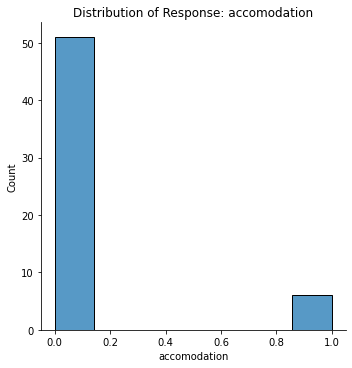

<Figure size 360x360 with 0 Axes>

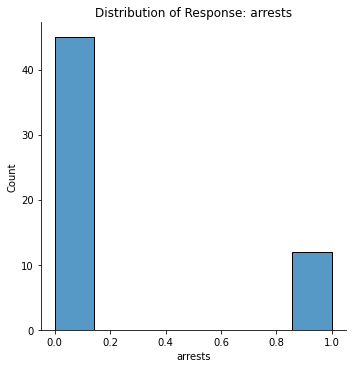

<Figure size 360x360 with 0 Axes>

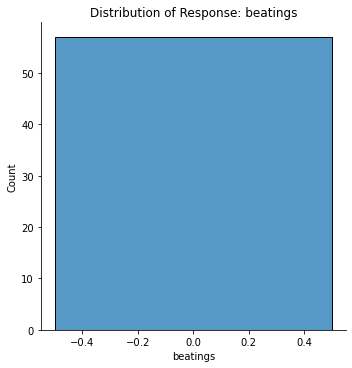

<Figure size 360x360 with 0 Axes>

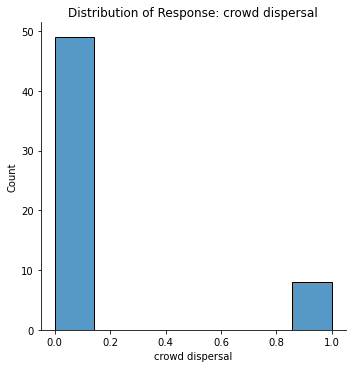

<Figure size 360x360 with 0 Axes>

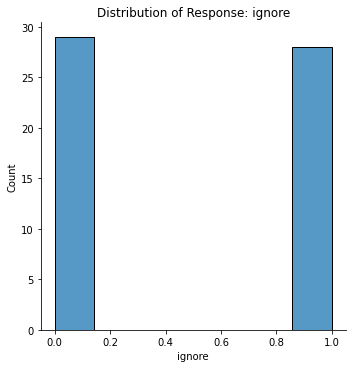

<Figure size 360x360 with 0 Axes>

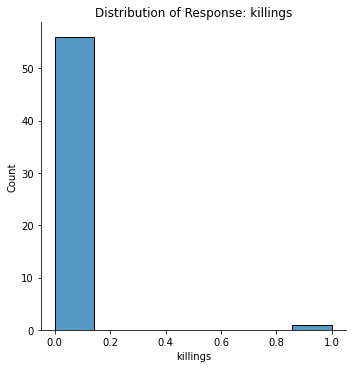

<Figure size 360x360 with 0 Axes>

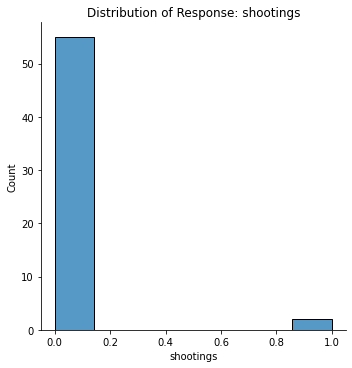

In [262]:
for response in list_of_responses:
    plt.figure(figsize = (5,5));
    # sns.boxplot(data=df_countries_test, orient = 'h')
    sns.displot(df_countries_test[response]);
    plt.title(f'Distribution of Response: {response}');

In [377]:
df_with_categories.groupby('region').mean()

,ccode,year,protest,protestnumber,startday,startmonth,startyear,endday,endmonth,endyear,protesterviolence,total_days,protesterdemand,stateresponse,state_violence,labor wage dispute,land farm issue,police brutality,"political behavior, process","price increases, tax policy",removal of politician,social restrictions,.,accomodation,arrests,beatings,crowd dispersal,ignore,killings,shootings,.
region,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Africa,501.854545,2006.076309,0.838292,7.411570,15.806441,6.141637,2006.391061,15.890569,6.147880,2006.392047,0.373973,0.634407,32592.631129,93027.800000,0.107438,0.137190,0.035537,0.054545,0.570523,0.066667,0.110193,0.028375,0.059229,0.105785,0.140220,0.064463,0.365565,0.347934,0.085124,0.107438,0.141322
Asia,760.504545,2005.472727,0.905152,6.538788,15.073652,6.245732,2005.584198,15.281553,6.282223,2005.586207,0.273691,2.054068,58342.423030,58621.944848,0.045455,0.086061,0.057879,0.093636,0.562424,0.058485,0.095758,0.051515,0.036364,0.114545,0.136061,0.072727,0.270303,0.458788,0.050606,0.045455,0.079394
Central America,92.061983,2004.493802,0.902893,3.330579,15.974828,6.157895,2004.288330,15.848970,6.215103,2004.288330,0.315789,1.618993,10629.384298,47634.144628,0.105372,0.126033,0.061983,0.014463,0.644628,0.159091,0.136364,0.004132,0.064050,0.074380,0.109504,0.028926,0.283058,0.535124,0.043388,0.105372,0.157025
Europe,295.352283,2005.176047,0.911692,9.220959,15.495115,6.241322,2005.211391,15.515901,6.241322,2005.214301,0.181780,1.082935,51143.353800,9685.845177,0.007770,0.170741,0.028994,0.038848,0.676142,0.113511,0.087360,0.047754,0.060262,0.071063,0.104794,0.029373,0.211105,0.616449,0.006443,0.007770,0.106121
MENA,651.962411,2008.188652,0.777305,4.980142,15.597628,5.715328,2009.766423,15.714416,5.729015,2009.772810,0.223451,2.865420,49188.383688,99481.717021,0.100000,0.058156,0.011348,0.108511,0.568085,0.063830,0.152482,0.046809,0.081560,0.064539,0.122695,0.067376,0.239007,0.342553,0.091489,0.100000,0.129787
North America,47.139286,2006.576786,0.892857,6.605357,14.434000,6.098000,2006.650000,14.326000,6.170000,2006.652000,0.294000,2.818000,13663.751786,42582.901786,0.078571,0.058929,0.017857,0.100000,0.662500,0.071429,0.155357,0.010714,0.035714,0.080357,0.169643,0.023214,0.167857,0.514286,0.039286,0.078571,0.139286
Oceania,910.000000,2004.061224,0.775510,1.469388,17.815789,6.500000,2003.578947,17.578947,6.578947,2003.578947,0.260870,2.171053,5429.816327,41679.265306,0.061224,0.081633,0.040816,0.122449,0.428571,0.000000,0.122449,0.000000,0.020408,0.285714,0.020408,0.000000,0.244898,0.346939,0.040816,0.061224,0.040816
South America,130.816697,2003.438596,0.969147,4.701149,15.358926,6.129213,2003.288390,15.878901,6.158552,2003.294007,0.199507,3.465356,19933.588627,54049.655172,0.029643,0.171204,0.019359,0.040532,0.721113,0.079855,0.038113,0.017544,0.032668,0.108893,0.114338,0.013914,0.318209,0.544465,0.052027,0.029643,0.068361


In [378]:
df_with_categories.groupby('country').mean().sort_values('accomodation', ascending = False)

,ccode,year,protest,protestnumber,startday,startmonth,startyear,endday,endmonth,endyear,protesterviolence,total_days,protesterdemand,stateresponse,state_violence,labor wage dispute,land farm issue,police brutality,"political behavior, process","price increases, tax policy",removal of politician,social restrictions,.,accomodation,arrests,beatings,crowd dispersal,ignore,killings,shootings,.
country,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
Madagascar,580.0,2008.516667,0.916667,11.991667,16.027273,5.427273,2009.181818,15.600000,5.363636,2009.190909,0.254545,0.950000,1452.633333,119662.091667,0.116667,0.050000,0.008333,0.008333,0.466667,0.016667,0.533333,0.000000,0.425000,0.425000,0.091667,0.016667,0.150000,0.250000,0.116667,0.116667,0.433333
Bolivia,145.0,2001.946565,1.000000,3.893130,15.832061,5.671756,2001.946565,16.847328,5.687023,2001.961832,0.412214,7.053435,43262.641221,87548.030534,0.083969,0.167939,0.045802,0.045802,0.656489,0.083969,0.045802,0.038168,0.045802,0.320611,0.160305,0.022901,0.427481,0.496183,0.083969,0.083969,0.099237
Papua New Guinea,910.0,2004.061224,0.775510,1.469388,17.815789,6.500000,2003.578947,17.578947,6.578947,2003.578947,0.260870,2.171053,5429.816327,41679.265306,0.061224,0.081633,0.040816,0.122449,0.428571,0.000000,0.122449,0.000000,0.020408,0.285714,0.020408,0.000000,0.244898,0.346939,0.040816,0.061224,0.040816
Vietnam,816.0,2003.857143,0.542857,0.685714,12.052632,5.684211,2004.842105,16.842105,6.368421,2004.842105,0.322581,25.657895,140349.600000,6020.800000,0.000000,0.085714,0.257143,0.028571,0.171429,0.057143,0.057143,0.114286,0.057143,0.228571,0.200000,0.057143,0.285714,0.057143,0.000000,0.000000,0.085714
Namibia,565.0,2007.733906,0.965665,7.227468,15.911111,6.551111,2007.928889,15.848889,6.617778,2007.933333,0.128889,3.593333,104699.690987,1607.090129,0.012876,0.201717,0.098712,0.030043,0.678112,0.060086,0.098712,0.094421,0.004292,0.223176,0.038627,0.012876,0.180258,0.643777,0.000000,0.012876,0.060086
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Serbia,342.0,2015.838710,0.774194,3.580645,16.083333,5.208333,2017.083333,16.166667,5.208333,2017.083333,0.083333,0.083333,97968.419355,3335.806452,0.000000,0.000000,0.000000,0.064516,0.677419,0.000000,0.548387,0.096774,0.548387,0.000000,0.064516,0.032258,0.096774,0.677419,0.000000,0.000000,0.580645
Sudan,625.0,2011.126761,0.732394,3.647887,15.884615,5.519231,2014.673077,15.769231,5.538462,2014.673077,0.217391,0.471154,58483.450704,196842.394366,0.056338,0.000000,0.000000,0.183099,0.352113,0.183099,0.295775,0.056338,0.338028,0.000000,0.239437,0.126761,0.478873,0.154930,0.183099,0.056338,0.352113
Serbia and Montenegro,347.0,2004.200000,0.400000,0.600000,12.500000,8.000000,2003.000000,12.500000,8.000000,2003.000000,0.500000,0.000000,2000.200000,20400.000000,0.000000,0.000000,0.000000,0.200000,0.200000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.200000,0.400000,0.000000,0.000000,0.000000,0.000000


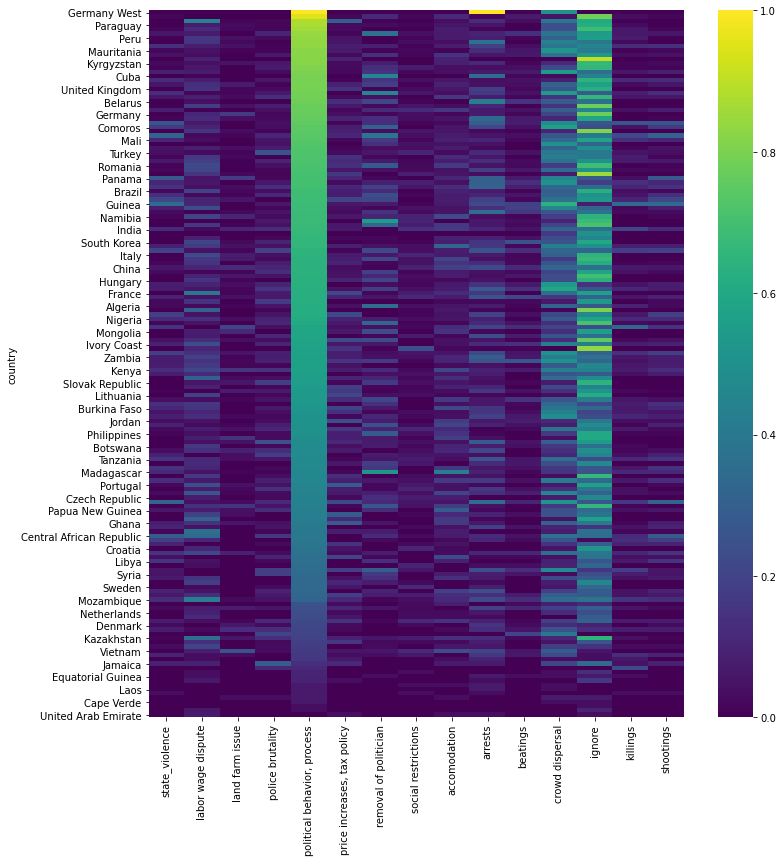

In [379]:
df_country = df_with_categories.groupby('country').mean().sort_values('political behavior, process', ascending = False).drop(columns = ['ccode','year','protest','protestnumber','startday','startmonth','startyear','endday','endmonth','endyear','protesterviolence', 'total_days', 'protesterdemand', 'stateresponse','.'])

plt.figure(figsize = (12,13))
sns.heatmap(df_country,
            vmin = 0,
            vmax = 1,
            cmap = 'viridis');

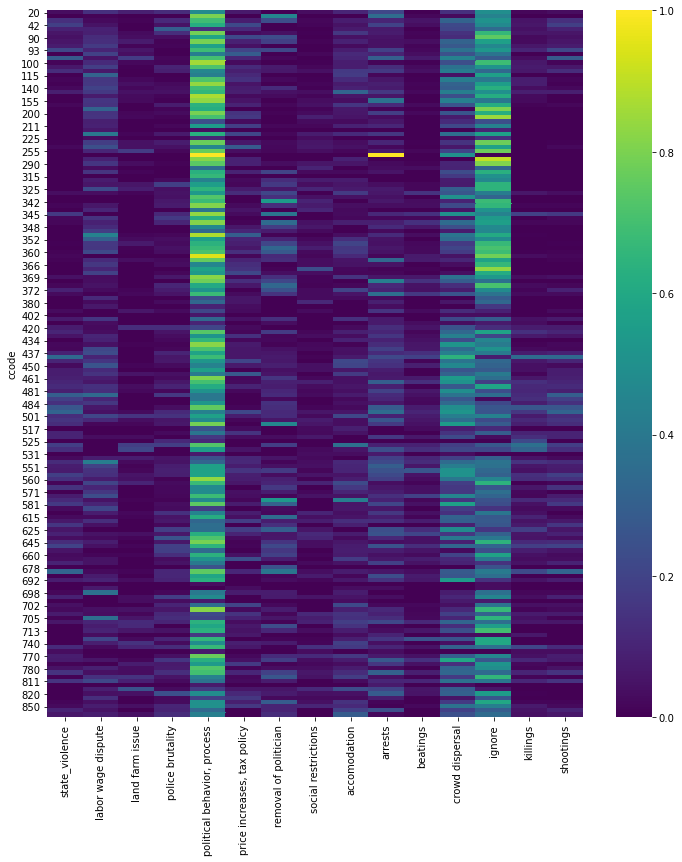

In [380]:
df_country = df_with_categories.groupby('ccode').mean().drop(columns = ['year','protest','protestnumber','startday','startmonth','startyear','endday','endmonth','endyear','protesterviolence', 'total_days', 'protesterdemand', 'stateresponse','.'])

plt.figure(figsize = (12,13))
sns.heatmap(df_country,
            vmin = 0,
            vmax = 1,
            cmap = 'viridis');

In [381]:
countries = list(df_with_categories['country'].unique())

In [382]:
countries = list(df['country'].unique())
countries

['Canada',
 'Cuba',
 'Haiti',
 'Dominican Republic',
 'Jamaica',
 'Mexico',
 'Guatemala',
 'Honduras',
 'El Salvador',
 'Nicaragua',
 'Costa Rica',
 'Panama',
 'Colombia',
 'Venezuela',
 'Guyana',
 'Suriname',
 'Ecuador',
 'Peru',
 'Brazil',
 'Bolivia',
 'Paraguay',
 'Chile',
 'Argentina',
 'Uruguay',
 'United Kingdom',
 'Ireland',
 'Netherlands',
 'Belgium',
 'Luxembourg',
 'France',
 'Switzerland',
 'Spain',
 'Portugal',
 'Germany',
 'Germany West',
 'Germany East',
 'Poland',
 'Austria',
 'Hungary',
 'Czechoslovakia',
 'Czech Republic',
 'Slovak Republic',
 'Italy',
 'Albania',
 'Kosovo',
 'Serbia',
 'Macedonia',
 'Croatia',
 'Yugoslavia',
 'Bosnia',
 'Serbia and Montenegro',
 'Montenegro',
 'Slovenia',
 'Greece',
 'Cyprus',
 'Bulgaria',
 'Moldova',
 'Romania',
 'USSR',
 'Russia',
 'Estonia',
 'Latvia',
 'Lithuania',
 'Ukraine',
 'Belarus',
 'Armenia',
 'Georgia',
 'Azerbaijan',
 'Finland',
 'Sweden',
 'Norway',
 'Denmark',
 'Cape Verde',
 'Guinea-Bissau',
 'Equatorial Guinea',
 'Ga

In [383]:
xticks = list(range(1990,2020,1))

In [384]:
df_with_categories.head()

,country,ccode,year,region,protest,protestnumber,startday,startmonth,startyear,endday,endmonth,endyear,protesterviolence,location,participants_category,participants,protesteridentity,sources,notes,total_days,protesterdemand,stateresponse,state_violence,labor wage dispute,land farm issue,police brutality,"political behavior, process","price increases, tax policy",removal of politician,social restrictions,.,accomodation,arrests,beatings,crowd dispersal,ignore,killings,shootings,.
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
201990001,Canada,20,1990,North America,1,1,15.0,1.0,1990.0,15.0,1.0,1990.0,0.0,national,NaN,1000s,unspecified,1. Great Canadian train journeys into history;...,Canada s railway passenger system was finally...,0.0,11.0,10.0,0.0,1,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990002,Canada,20,1990,North America,1,2,25.0,6.0,1990.0,25.0,6.0,1990.0,0.0,"Montreal, Quebec",NaN,1000,unspecified,1. Autonomy s Cry Revived in Quebec The New Yo...,protestors were only identified as young peop...,0.0,1.0,10.0,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990003,Canada,20,1990,North America,1,3,1.0,7.0,1990.0,1.0,7.0,1990.0,0.0,"Montreal, Quebec",NaN,500,separatist Parti Quebecois,1. Quebec protest after Queen calls for unity ...,"THE Queen, after calling on Canadians to rema...",0.0,1.0,10.0,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990004,Canada,20,1990,North America,1,4,12.0,7.0,1990.0,6.0,9.0,1990.0,1.0,"Montreal, Quebec",NaN,100s,Mohawk Indians,1. Indians Gather as Siege Intensifies; Armed ...,Canada s federal government has agreed to acq...,55.0,100000.0,1.0,0.0,0,1,0,0,0,0,0.0,0.0,1,0,0,0.0,0.0,0,0.0,0.0
201990005,Canada,20,1990,North America,1,5,14.0,8.0,1990.0,15.0,8.0,1990.0,1.0,"Montreal, Quebec",NaN,950,local residents,1. Dozens hurt in Mohawk blockade protest The ...,Protests were directed against the state due t...,1.0,1.0,1101.0,0.0,0,0,0,1,0,0,0.0,0.0,1,1,0,1.0,0.0,0,0.0,0.0


<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-385-9574e2319d19>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

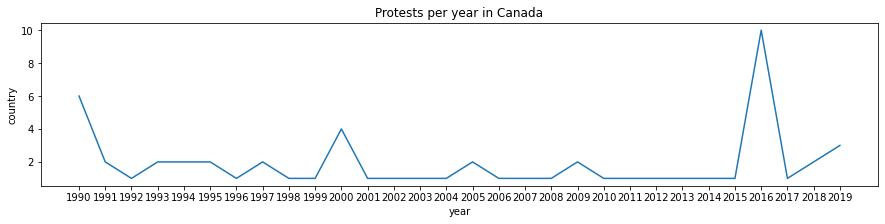

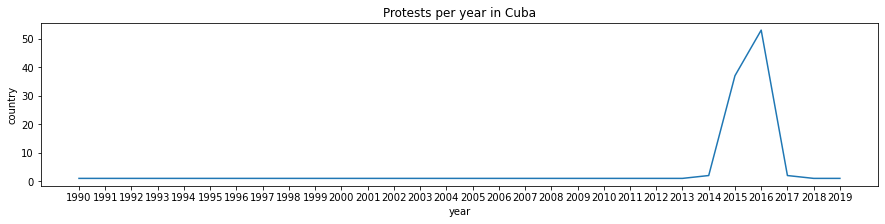

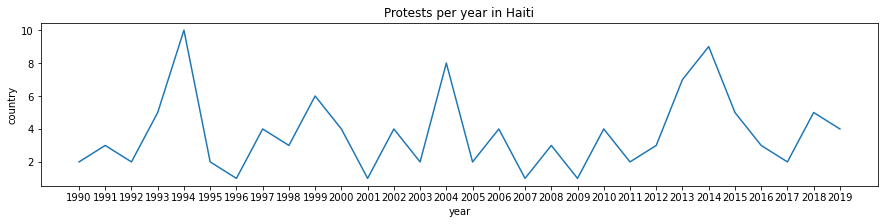

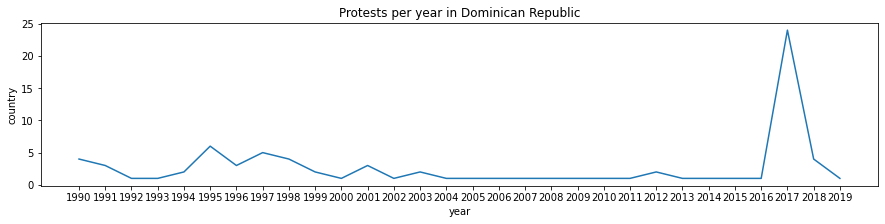

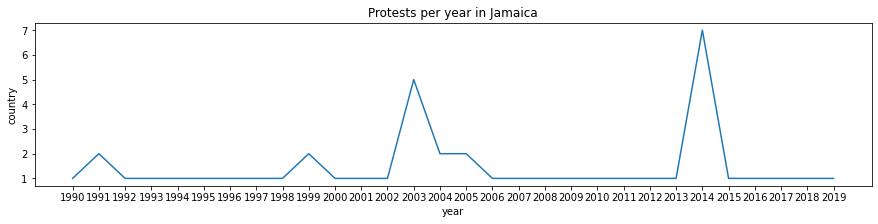

...

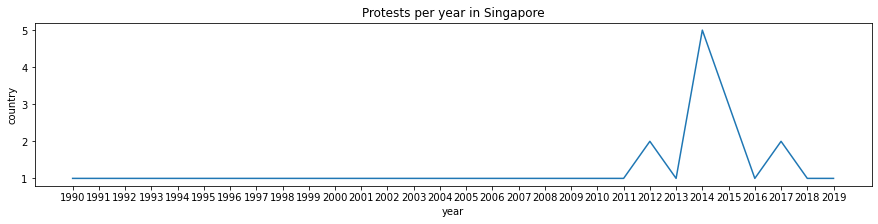

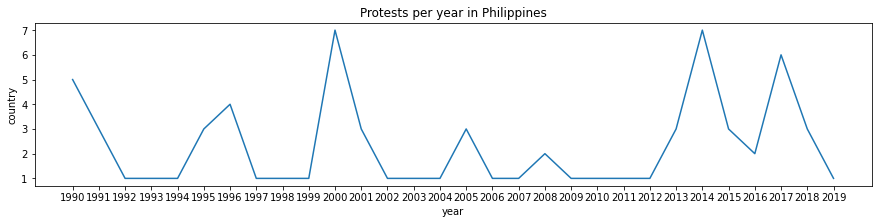

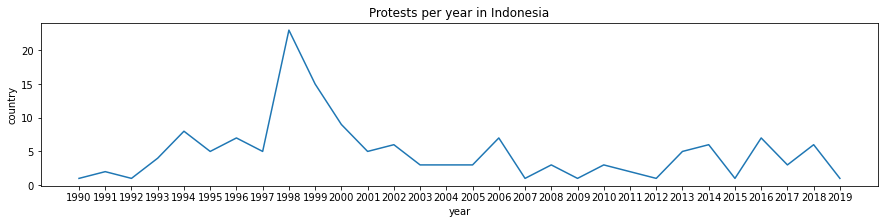

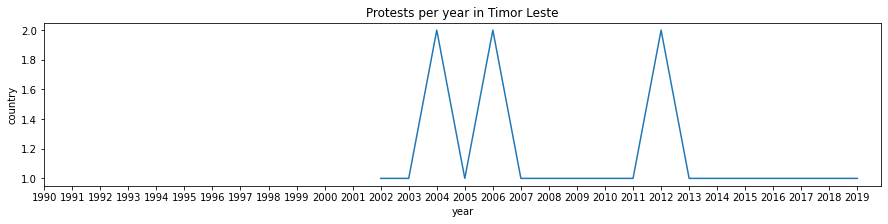

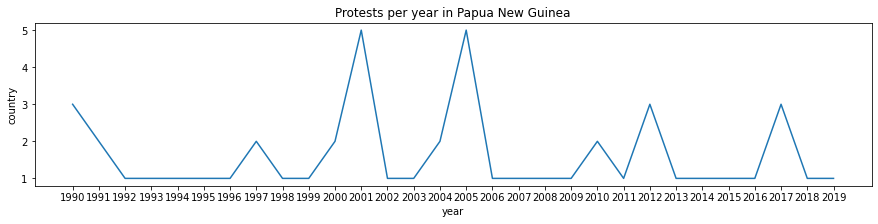

In [385]:
for country in countries:
    data = df_with_categories[df_with_categories['country'] == country].groupby('year').count()['country']

    plt.figure(figsize = (15,3))
    sns.lineplot(x = data.index, y = data)
    plt.xticks(xticks,xticks)
    plt.title(f'Protests per year in {country}')

In [386]:
df_with_categories[df_with_categories['country'] == 'France'].groupby('year').sum()['accomodation']

year
1990    4
1991    3
1992    1
1993    2
1994    5
1995    7
1996    4
1997    7
1998    4
1999    1
2000    3
2001    0
2002    1
2003    2
2004    0
2005    1
2006    3
2007    0
2008    2
2009    1
2010    0
2011    0
2012    0
2013    1
2014    0
2015    4
2016    2
2017    0
2018    4
2019    1
Name: accomodation, dtype: uint8

In [387]:
df_with_categories.head()

,country,ccode,year,region,protest,protestnumber,startday,startmonth,startyear,endday,endmonth,endyear,protesterviolence,location,participants_category,participants,protesteridentity,sources,notes,total_days,protesterdemand,stateresponse,state_violence,labor wage dispute,land farm issue,police brutality,"political behavior, process","price increases, tax policy",removal of politician,social restrictions,.,accomodation,arrests,beatings,crowd dispersal,ignore,killings,shootings,.
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
201990001,Canada,20,1990,North America,1,1,15.0,1.0,1990.0,15.0,1.0,1990.0,0.0,national,NaN,1000s,unspecified,1. Great Canadian train journeys into history;...,Canada s railway passenger system was finally...,0.0,11.0,10.0,0.0,1,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990002,Canada,20,1990,North America,1,2,25.0,6.0,1990.0,25.0,6.0,1990.0,0.0,"Montreal, Quebec",NaN,1000,unspecified,1. Autonomy s Cry Revived in Quebec The New Yo...,protestors were only identified as young peop...,0.0,1.0,10.0,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990003,Canada,20,1990,North America,1,3,1.0,7.0,1990.0,1.0,7.0,1990.0,0.0,"Montreal, Quebec",NaN,500,separatist Parti Quebecois,1. Quebec protest after Queen calls for unity ...,"THE Queen, after calling on Canadians to rema...",0.0,1.0,10.0,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990004,Canada,20,1990,North America,1,4,12.0,7.0,1990.0,6.0,9.0,1990.0,1.0,"Montreal, Quebec",NaN,100s,Mohawk Indians,1. Indians Gather as Siege Intensifies; Armed ...,Canada s federal government has agreed to acq...,55.0,100000.0,1.0,0.0,0,1,0,0,0,0,0.0,0.0,1,0,0,0.0,0.0,0,0.0,0.0
201990005,Canada,20,1990,North America,1,5,14.0,8.0,1990.0,15.0,8.0,1990.0,1.0,"Montreal, Quebec",NaN,950,local residents,1. Dozens hurt in Mohawk blockade protest The ...,Protests were directed against the state due t...,1.0,1.0,1101.0,0.0,0,0,0,1,0,0,0.0,0.0,1,1,0,1.0,0.0,0,0.0,0.0


In [388]:
cols_to_drop = list (df_with_categories[df_with_categories['country'] == 'France'].groupby('year').sum()[list_of_demands].sum()[df_with_categories[df_with_categories['country'] == 'France'].groupby('year').sum()[list_of_demands].sum() == 0].index)

In [389]:
list_of_demands 

['labor wage dispute',
 'land farm issue',
 'police brutality',
 'political behavior, process',
 'price increases, tax policy',
 'removal of politician',
 'social restrictions']

<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize

<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize

<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize

<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize

<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize

<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-390-268b0a3b8e98>:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize

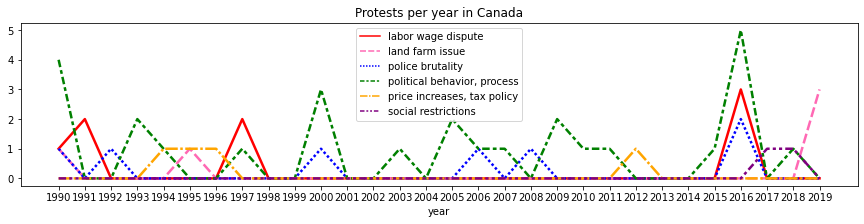

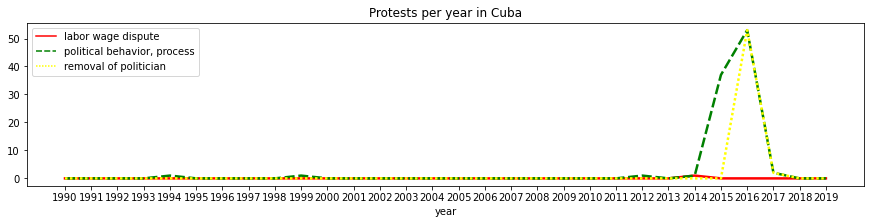

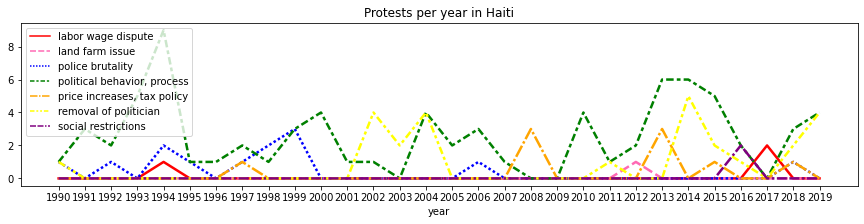

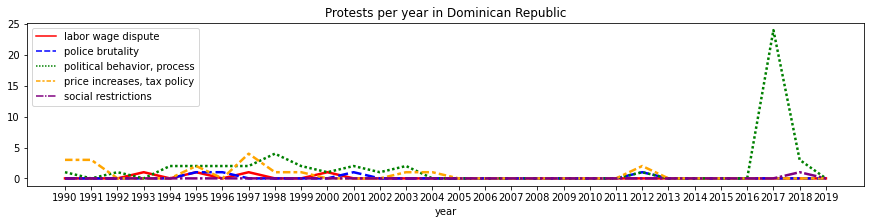

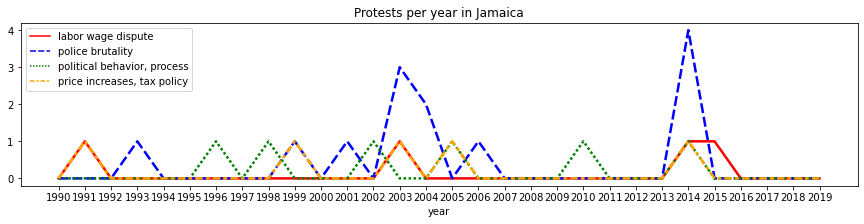

...

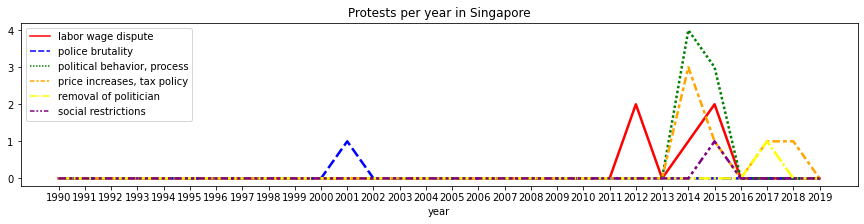

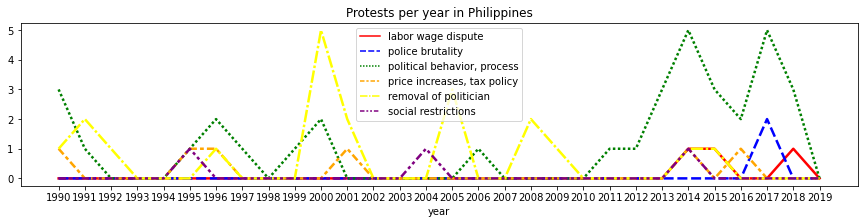

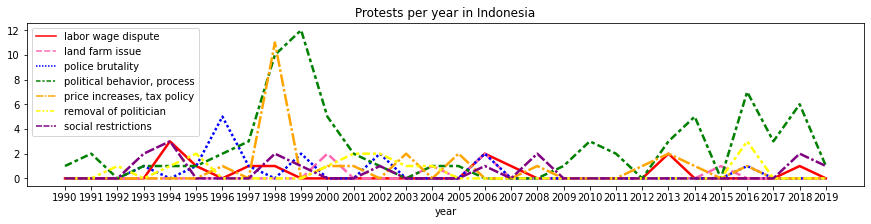

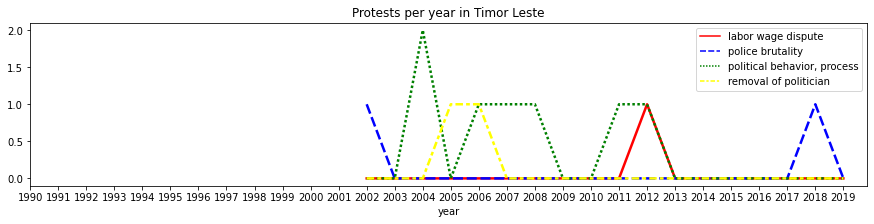

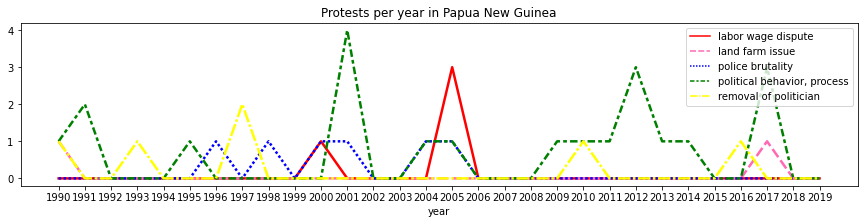

In [390]:
demands_palette = {'labor wage dispute':'red',
           'land farm issue': 'hotpink',
           'police brutality': 'blue',
           'political behavior, process': 'green',
           'price increases, tax policy': 'orange',
           'removal of politician': 'yellow',
           'social restrictions': 'purple'}

country = 'France'
for country in countries:

    cols_to_drop = list (df_with_categories[df_with_categories['country'] == country].groupby('year').sum()[list_of_demands].sum()[df_with_categories[df_with_categories['country'] == country].groupby('year').sum()[list_of_demands].sum() == 0].index)
    data = df_with_categories[df_with_categories['country'] == country].groupby('year').sum()[list_of_demands].drop(columns = cols_to_drop)

    plt.figure(figsize = (15,3))
    sns.lineplot(data = data, palette = demands_palette, linewidth=2.5)
    plt.xticks(xticks,xticks)
    plt.title(f'Protests per year in {country}')

<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-391-d39d85f5b8c7>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

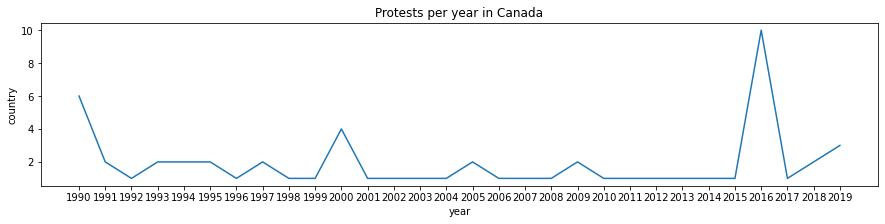

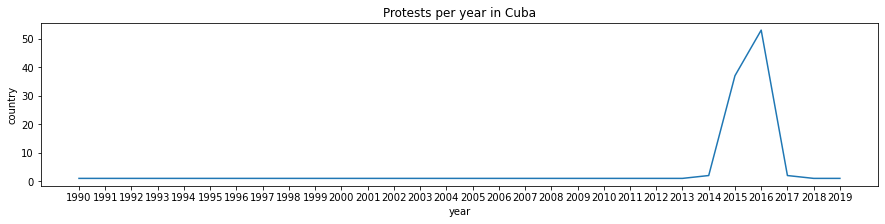

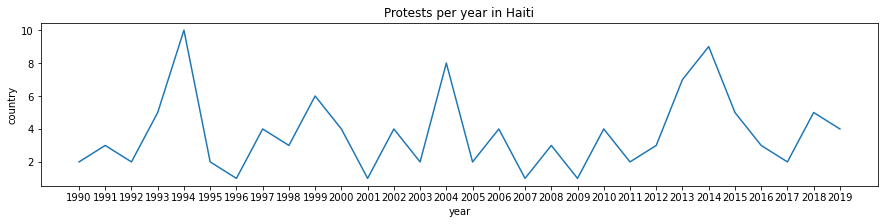

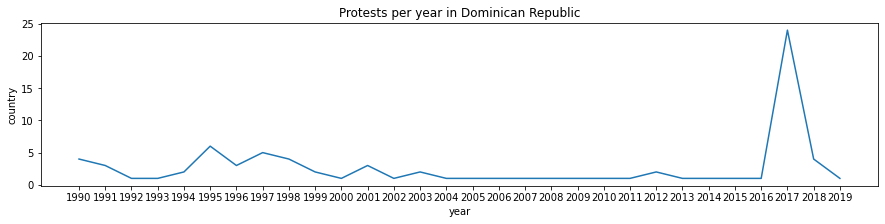

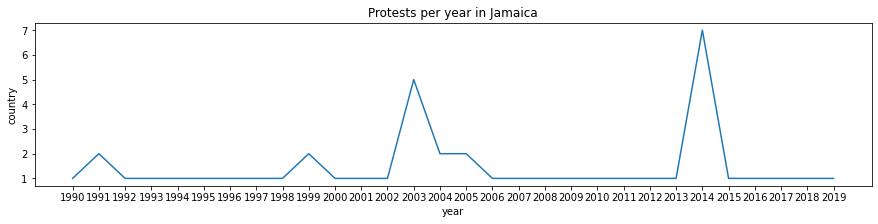

...

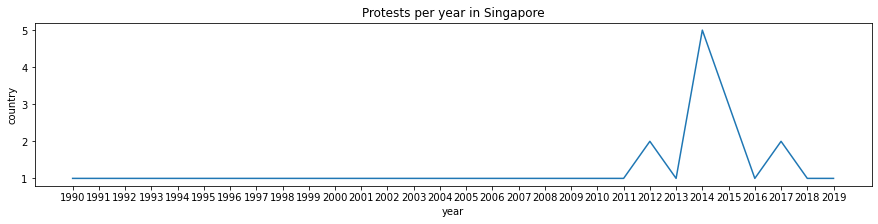

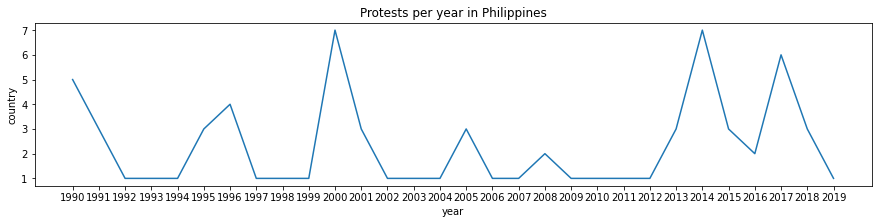

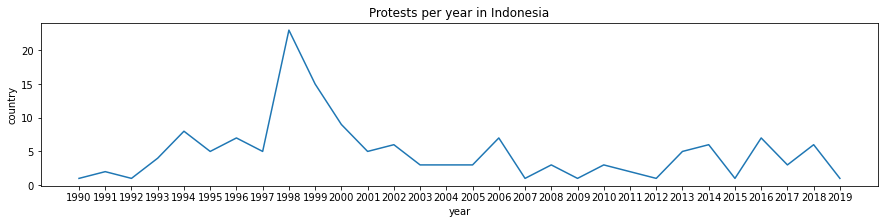

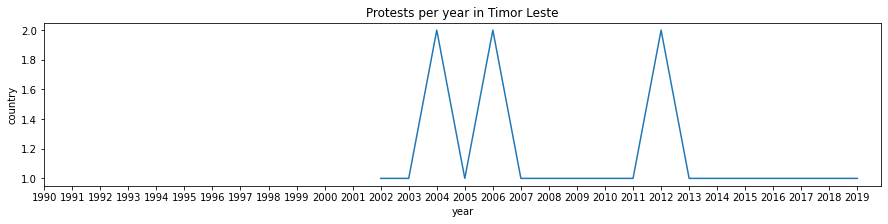

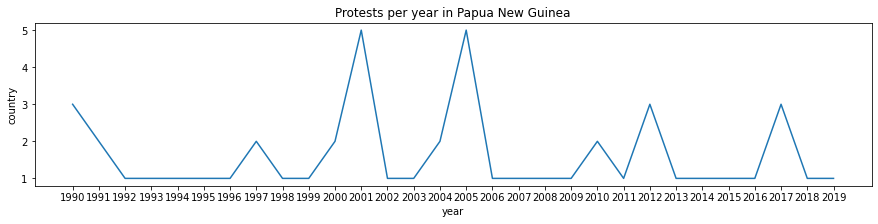

In [391]:
for country in countries:
    data = df[df['country'] == country].groupby('year').count()['country']

    plt.figure(figsize = (15,3))
    sns.lineplot(x = data.index, y = data)
    plt.xticks(xticks,xticks)
    plt.title(f'Protests per year in {country}')

In [392]:
list_of_responses

['accomodation',
 'arrests',
 'beatings',
 'crowd dispersal',
 'ignore',
 'killings',
 'shootings']

<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize

<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize

<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize

<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize

<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize

<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-393-2f203a318edd>:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize

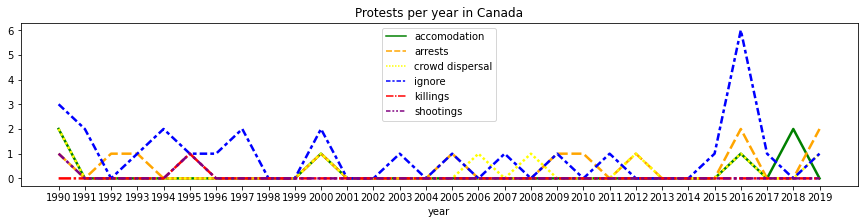

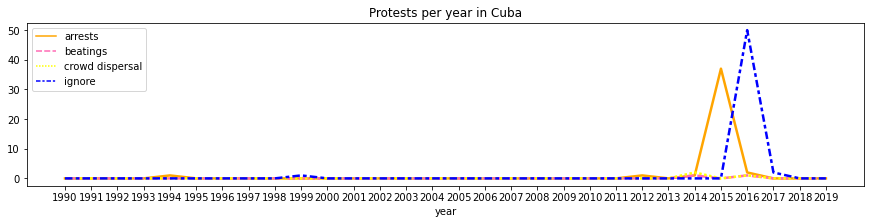

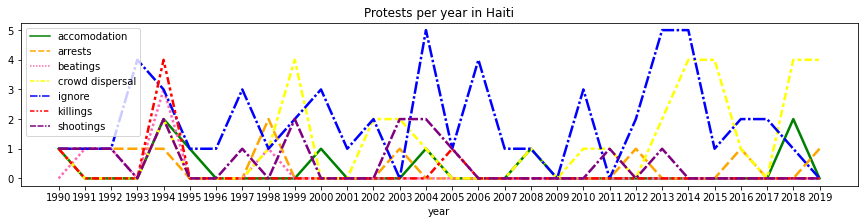

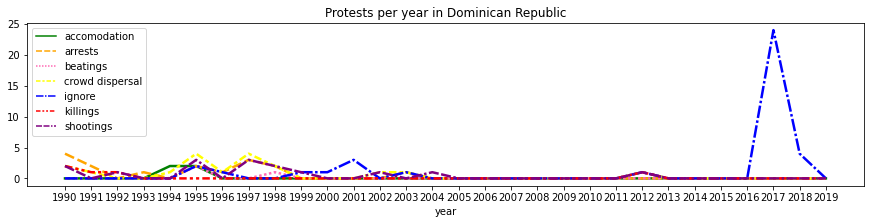

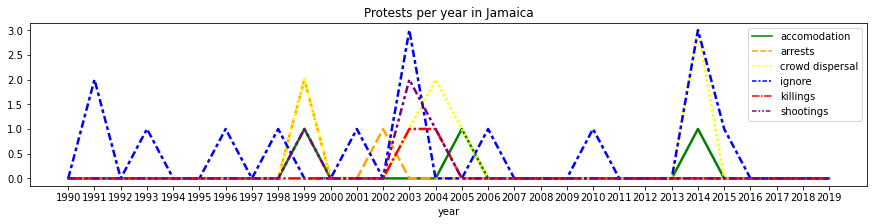

...

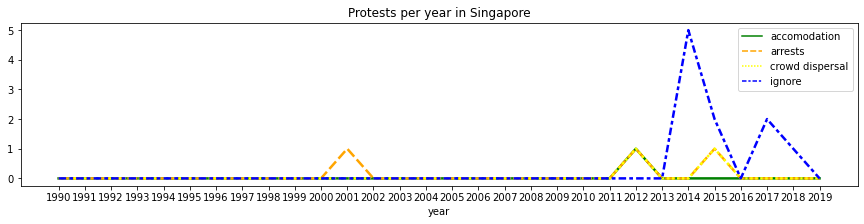

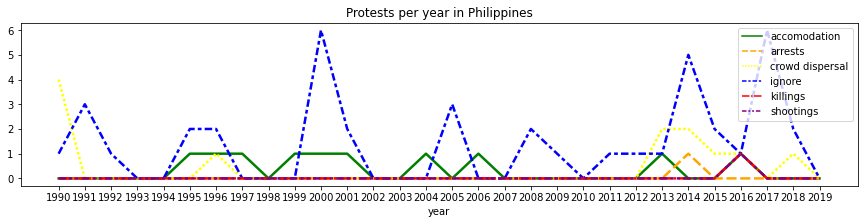

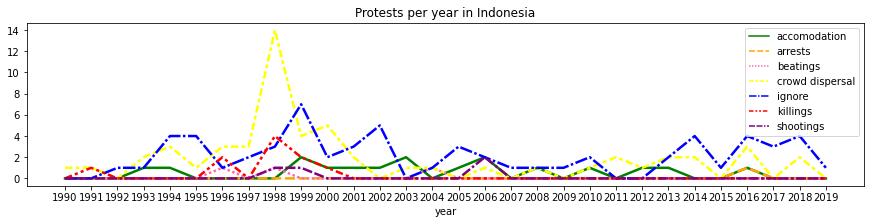

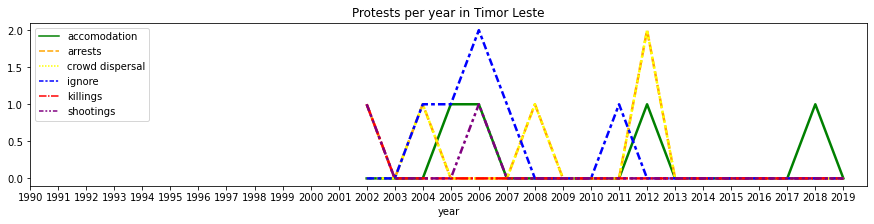

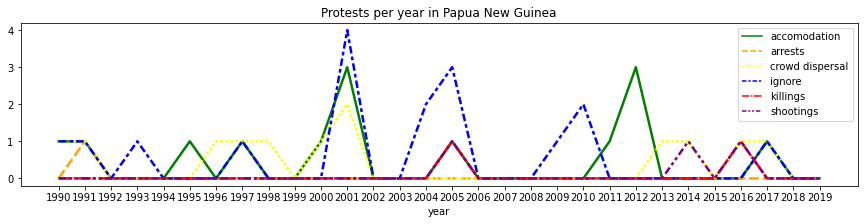

In [393]:
response_palette = {'accomodation':'green',
           'arrests': 'orange',
           'beatings': 'hotpink',
           'crowd dispersal': 'yellow',
           'ignore': 'blue',
           'killings': 'red',
           'shootings': 'purple'}

country = 'France'
for country in countries:
    
    df_for_country_bool = (df_with_categories['country'] == country)
    years_summed = df_with_categories[df_for_country_bool].groupby('year').sum()
    years_summed_just_responses = years_summed[list_of_responses].sum()
    
    cols_to_drop = list(years_summed_just_responses[years_summed_just_responses == 0].index)
    data = years_summed[list_of_responses].drop(columns = cols_to_drop)

    plt.figure(figsize = (15,3))
    sns.lineplot(data = data, palette = response_palette, linewidth=2.5)
    plt.xticks(xticks,xticks)
    plt.title(f'Protests per year in {country}')

<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = (15,3))
<ipython-input-402-7850bb67d724>:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize = 

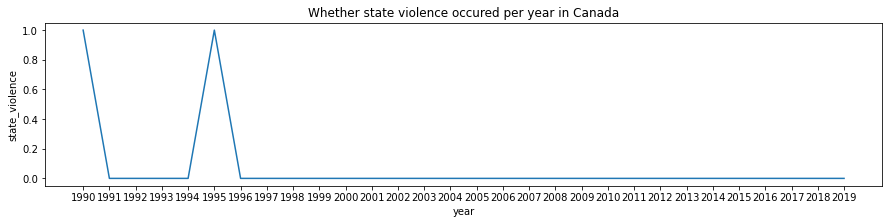

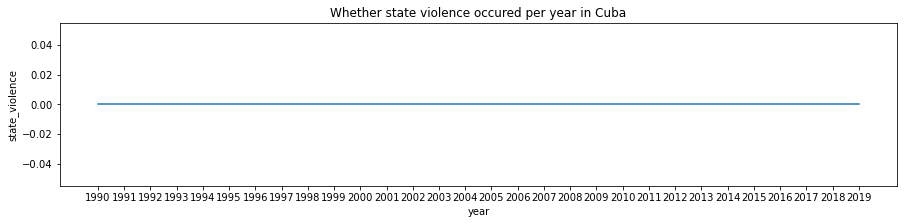

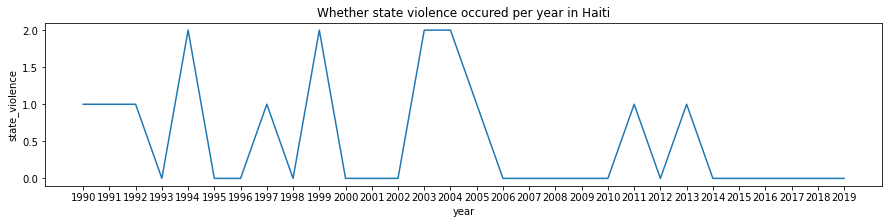

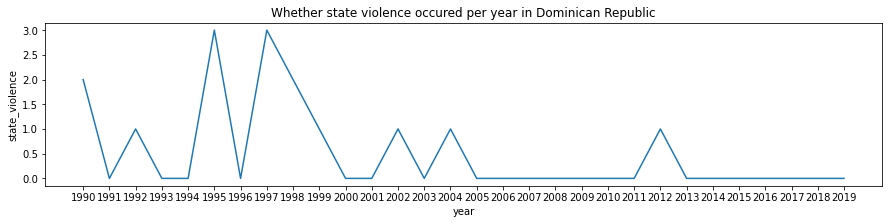

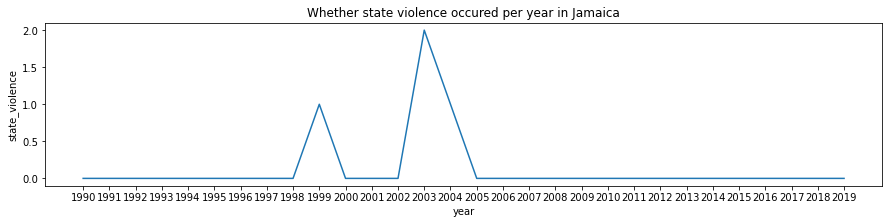

...

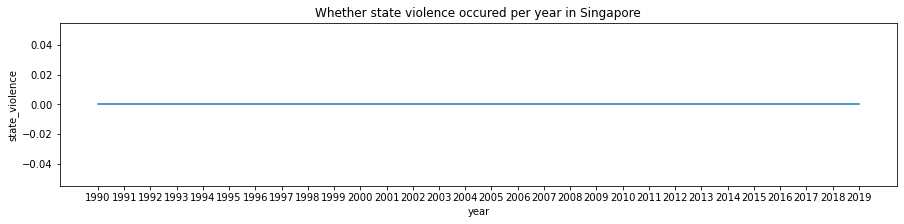

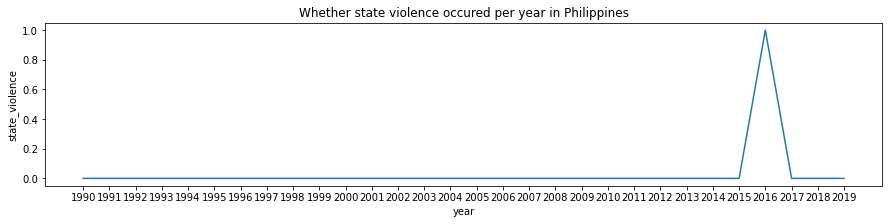

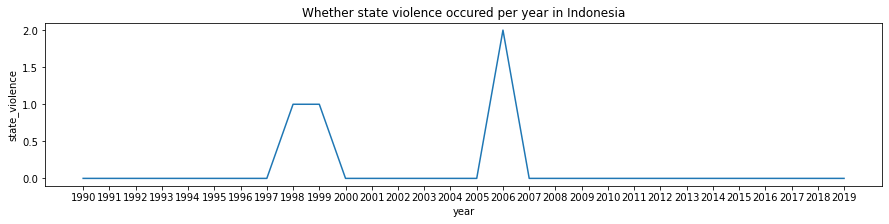

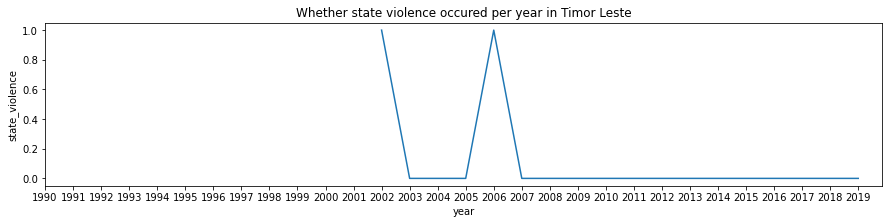

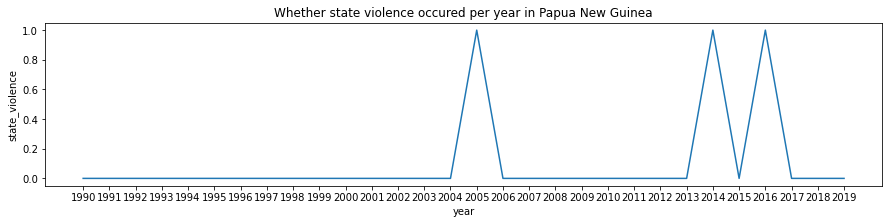

In [402]:
for country in countries:
    data = df[df['country'] == country].groupby('year').sum()['state_violence']

    plt.figure(figsize = (15,3))
    sns.lineplot(x = data.index, y = data)
    plt.xticks(xticks,xticks)
    plt.title(f'Whether state violence occured per year in {country}')

In [394]:
regions = list(df_with_categories['region'].unique())
regions

['North America',
 'Central America',
 'South America',
 'Europe',
 'Africa',
 'MENA',
 'Asia',
 'Oceania']

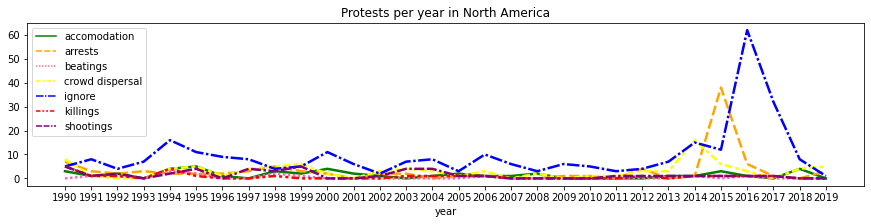

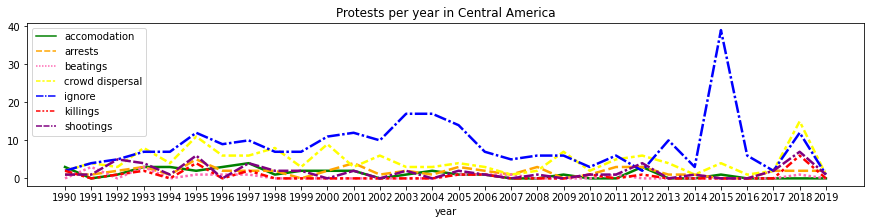

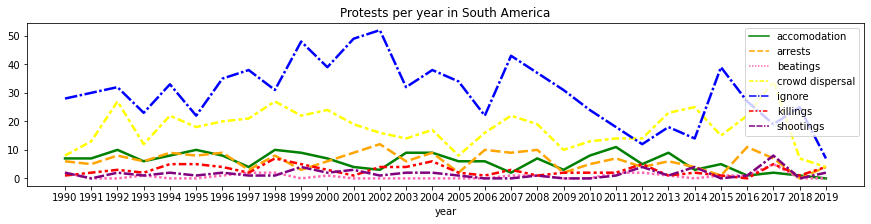

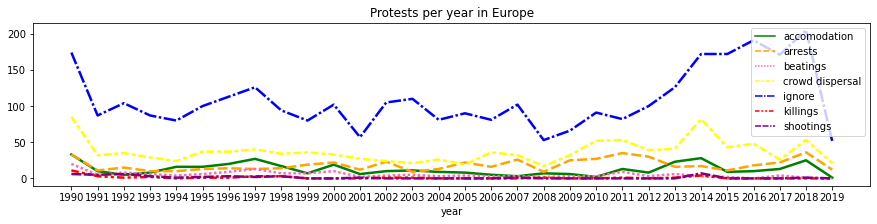

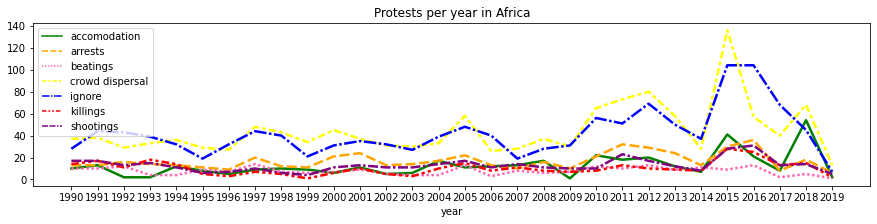

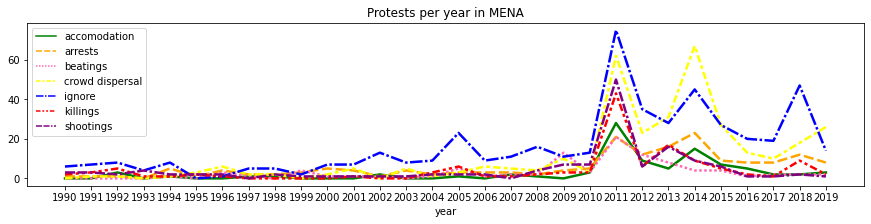

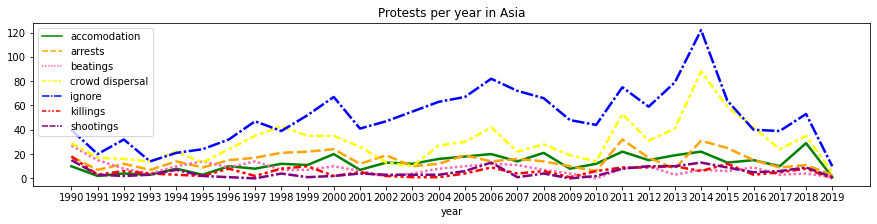

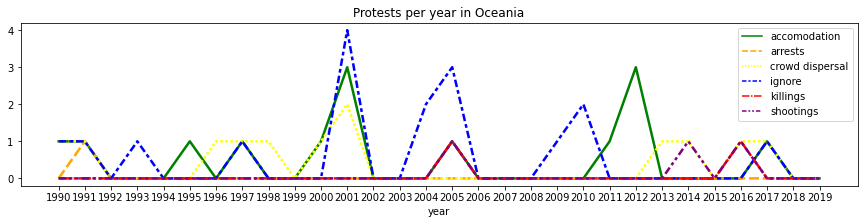

In [395]:
response_palette = {'accomodation':'green',
           'arrests': 'orange',
           'beatings': 'hotpink',
           'crowd dispersal': 'yellow',
           'ignore': 'blue',
           'killings': 'red',
           'shootings': 'purple'}

for region in regions:

    cols_to_drop = list (df_with_categories[df_with_categories['region'] == region].groupby('year').sum()[list_of_responses].sum()[df_with_categories[df_with_categories['region'] == region].groupby('year').sum()[list_of_responses].sum() == 0].index)
    data = df_with_categories[df_with_categories['region'] == region].groupby('year').sum()[list_of_responses].drop(columns = cols_to_drop)

    plt.figure(figsize = (15,3))
    sns.lineplot(data = data, palette = response_palette, linewidth=2.5)
    plt.xticks(xticks,xticks)
    plt.title(f'Protests per year in {region}')

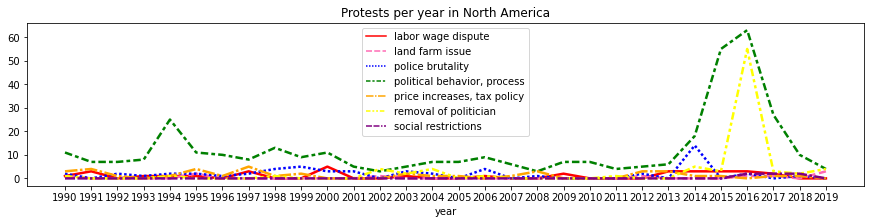

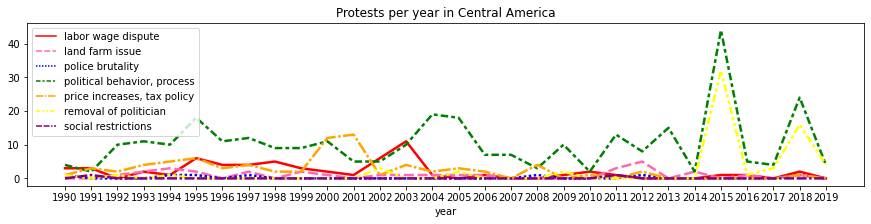

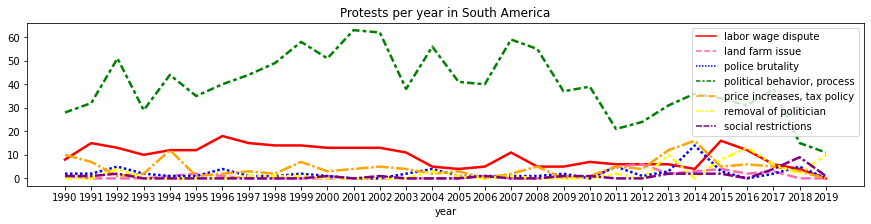

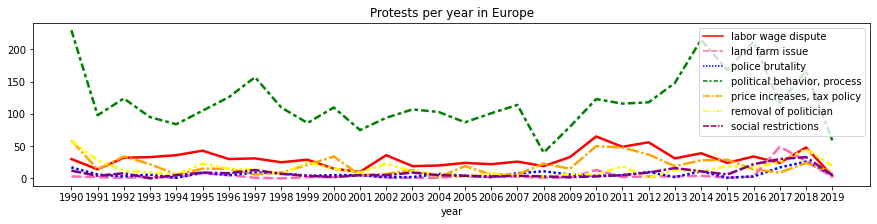

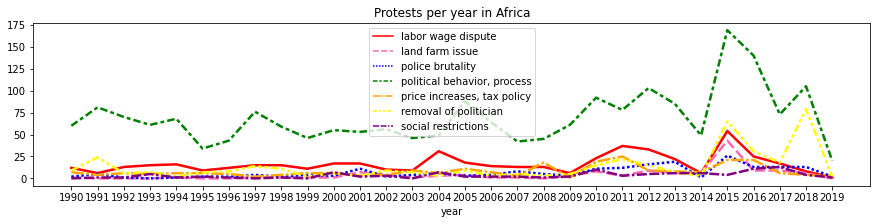

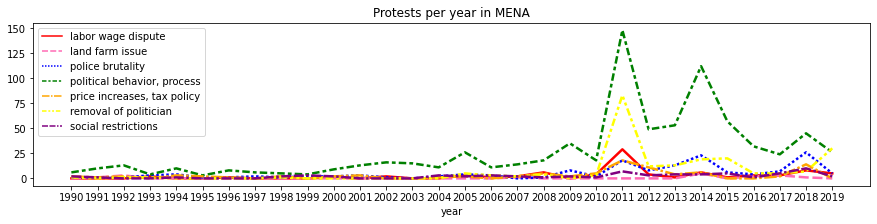

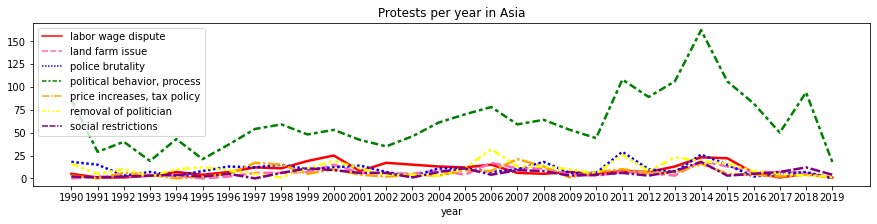

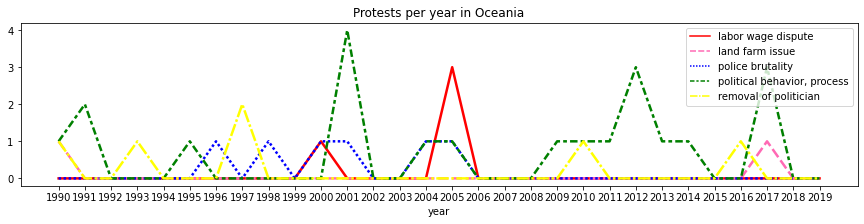

In [396]:
demands_palette = {'labor wage dispute':'red',
           'land farm issue': 'hotpink',
           'police brutality': 'blue',
           'political behavior, process': 'green',
           'price increases, tax policy': 'orange',
           'removal of politician': 'yellow',
           'social restrictions': 'purple'}

for region in regions:

    cols_to_drop = list (df_with_categories[df_with_categories['region'] == region].groupby('year').sum()[list_of_demands].sum()[df_with_categories[df_with_categories['region'] == region].groupby('year').sum()[list_of_demands].sum() == 0].index)
    data = df_with_categories[df_with_categories['region'] == region].groupby('year').sum()[list_of_demands].drop(columns = cols_to_drop)

    plt.figure(figsize = (15,3))
    sns.lineplot(data = data, palette = demands_palette, linewidth=2.5)
    plt.xticks(xticks,xticks)
    plt.title(f'Protests per year in {region}')

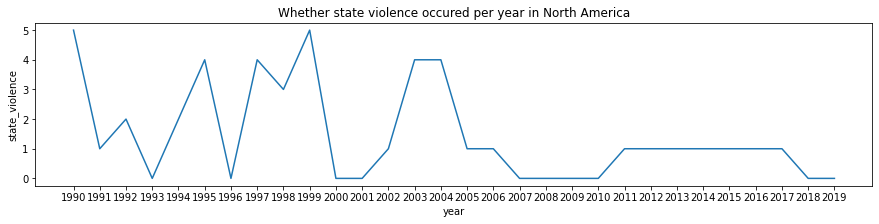

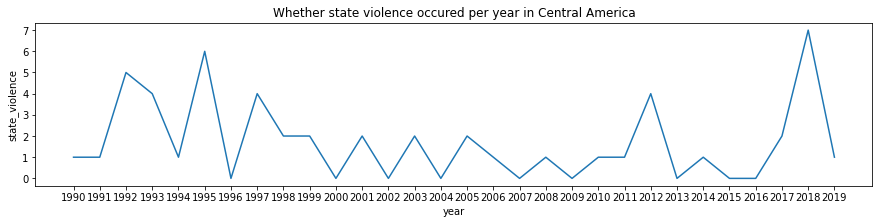

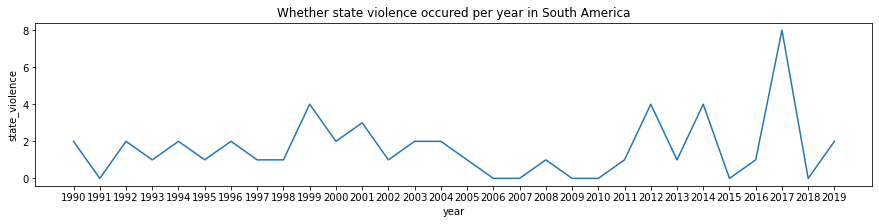

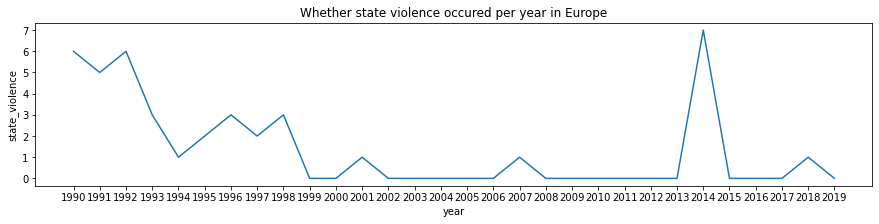

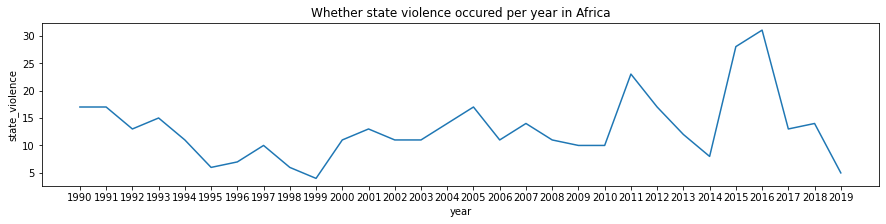

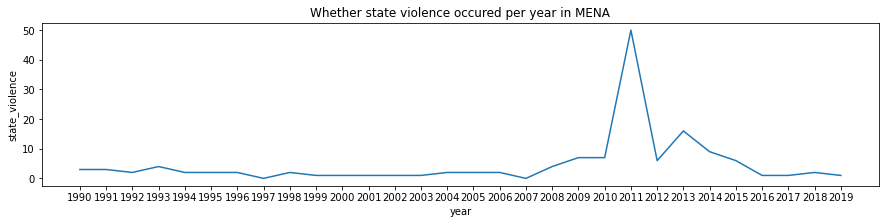

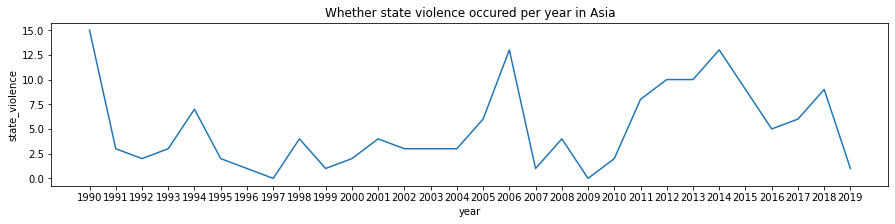

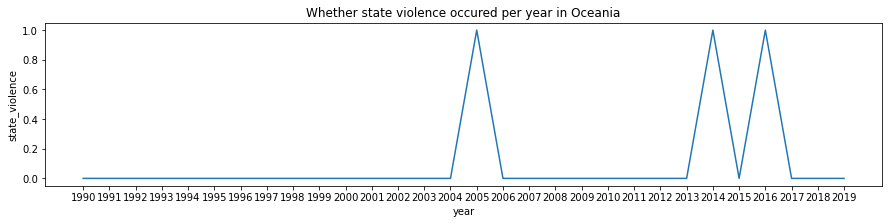

In [403]:
for region in regions:
    data = df[df['region'] == region].groupby('year').sum()['state_violence']

    plt.figure(figsize = (15,3))
    sns.lineplot(x = data.index, y = data)
    plt.xticks(xticks,xticks)
    plt.title(f'Whether state violence occured per year in {region}')

In [397]:
df_with_categories.head()

,country,ccode,year,region,protest,protestnumber,startday,startmonth,startyear,endday,endmonth,endyear,protesterviolence,location,participants_category,participants,protesteridentity,sources,notes,total_days,protesterdemand,stateresponse,state_violence,labor wage dispute,land farm issue,police brutality,"political behavior, process","price increases, tax policy",removal of politician,social restrictions,.,accomodation,arrests,beatings,crowd dispersal,ignore,killings,shootings,.
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
201990001,Canada,20,1990,North America,1,1,15.0,1.0,1990.0,15.0,1.0,1990.0,0.0,national,NaN,1000s,unspecified,1. Great Canadian train journeys into history;...,Canada s railway passenger system was finally...,0.0,11.0,10.0,0.0,1,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990002,Canada,20,1990,North America,1,2,25.0,6.0,1990.0,25.0,6.0,1990.0,0.0,"Montreal, Quebec",NaN,1000,unspecified,1. Autonomy s Cry Revived in Quebec The New Yo...,protestors were only identified as young peop...,0.0,1.0,10.0,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990003,Canada,20,1990,North America,1,3,1.0,7.0,1990.0,1.0,7.0,1990.0,0.0,"Montreal, Quebec",NaN,500,separatist Parti Quebecois,1. Quebec protest after Queen calls for unity ...,"THE Queen, after calling on Canadians to rema...",0.0,1.0,10.0,0.0,0,0,0,1,0,0,0.0,0.0,0,0,0,0.0,1.0,0,0.0,0.0
201990004,Canada,20,1990,North America,1,4,12.0,7.0,1990.0,6.0,9.0,1990.0,1.0,"Montreal, Quebec",NaN,100s,Mohawk Indians,1. Indians Gather as Siege Intensifies; Armed ...,Canada s federal government has agreed to acq...,55.0,100000.0,1.0,0.0,0,1,0,0,0,0,0.0,0.0,1,0,0,0.0,0.0,0,0.0,0.0
201990005,Canada,20,1990,North America,1,5,14.0,8.0,1990.0,15.0,8.0,1990.0,1.0,"Montreal, Quebec",NaN,950,local residents,1. Dozens hurt in Mohawk blockade protest The ...,Protests were directed against the state due t...,1.0,1.0,1101.0,0.0,0,0,0,1,0,0,0.0,0.0,1,1,0,1.0,0.0,0,0.0,0.0


In [398]:
list_of_responses

['accomodation',
 'arrests',
 'beatings',
 'crowd dispersal',
 'ignore',
 'killings',
 'shootings']

In [399]:
list_of_demands

['labor wage dispute',
 'land farm issue',
 'police brutality',
 'political behavior, process',
 'price increases, tax policy',
 'removal of politician',
 'social restrictions']

In [400]:
list_of_multi_response = []
count = 0

for response in list_of_responses:
    listshort = df_with_categories[list_of_responses][df_with_categories[response] > 1].index
    listshort = list(listshort)
    
    count += len(listshort)
    
    list_of_multi_response.append(listshort)

list_of_multi_response

[[1552011005,
  2201996003,
  2201997017,
  3522012004,
  3552013001,
  3601990024,
  3692013002,
  5652010003,
  6792014019,
  7102014028,
  7702013002],
 [1552011005, 7052011001, 8112015005],
 [3601990024],
 [1102012001,
  1352011005,
  1402015022,
  2001998008,
  2002013014,
  2201992021,
  2201995032,
  2201996003,
  2201997017,
  2552011008,
  3502013008,
  3522011014,
  3592003009,
  3601990034,
  3692013002,
  3692014006,
  5012010037,
  5162002003,
  5652011002,
  5652011005,
  6792014019,
  7102014028,
  7132014001,
  7702013002,
  7752015001],
 [3502012007],
 [5252012001, 5302005001],
 []]

In [401]:
count

43

In [312]:
len(df_with_categories)

16363

In [338]:
list_of_multi_demand = []
count = 0

for demand in list_of_demands:
    listshort = df_with_categories[list_of_demands][df_with_categories[demand] > 1].index
    listshort = list(listshort)
    
    count += len(listshort)
    
    list_of_multi_demand.append(listshort)

list_of_multi_demand

[[], [], [], [], [], [3551990014, 4901997001], []]

In [339]:
count

2